# Face Generation
In this project, you'll use generative adversarial networks to generate new images of faces.
### Get the Data
You'll be using two datasets in this project:
- MNIST
- CelebA

Since the celebA dataset is complex and you're doing GANs in a project for the first time, we want you to test your neural network on MNIST before CelebA.  Running the GANs on MNIST will allow you to see how well your model trains sooner.

If you're using [FloydHub](https://www.floydhub.com/), set `data_dir` to "/input" and use the [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [ ]:
data_dir = './data'

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

#helper.download_extract('mnist', data_dir)
#helper.download_extract('celeba', data_dir)

## Explore the Data
### MNIST
As you're aware, the [MNIST](http://yann.lecun.com/exdb/mnist/) dataset contains images of handwritten digits. You can view the first number of examples by changing `show_n_images`. 

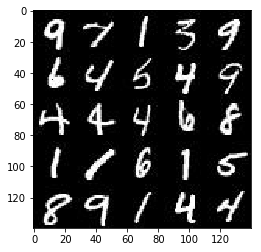

In [3]:
import helper
show_n_images = 25
data_dir = './data'

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
The [CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) dataset contains over 200,000 celebrity images with annotations.  Since you're going to be generating faces, you won't need the annotations.  You can view the first number of examples by changing `show_n_images`.

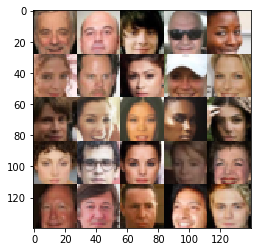

In [4]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## Preprocess the Data
Since the project's main focus is on building the GANs, we'll preprocess the data for you.  The values of the MNIST and CelebA dataset will be in the range of -0.5 to 0.5 of 28x28 dimensional images.  The CelebA images will be cropped to remove parts of the image that don't include a face, then resized down to 28x28.

The MNIST images are black and white images with a single [color channel](https://en.wikipedia.org/wiki/Channel_(digital_image%29) while the CelebA images have [3 color channels (RGB color channel)](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images).
## Build the Neural Network
You'll build the components necessary to build a GANs by implementing the following functions below:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### Check the Version of TensorFlow and Access to GPU
This will check to make sure you have the correct version of TensorFlow and access to a GPU

In [5]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.1.0
Default GPU Device: /gpu:0


### Input
Implement the `model_inputs` function to create TF Placeholders for the Neural Network. It should create the following placeholders:
- Real input images placeholder with rank 4 using `image_width`, `image_height`, and `image_channels`.
- Z input placeholder with rank 2 using `z_dim`.
- Learning rate placeholder with rank 0.

Return the placeholders in the following the tuple (tensor of real input images, tensor of z data)

In [6]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    input_real = tf.placeholder(tf.float32, shape=(None, image_height, image_width, image_channels))
    input_z = tf.placeholder(tf.float32, shape=(None, z_dim))
    learning_rate = tf.placeholder(tf.float32, shape=())

    return input_real, input_z, learning_rate

"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### Discriminator
Implement `discriminator` to create a discriminator neural network that discriminates on `images`.  This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "discriminator" to allow the variables to be reused.  The function should return a tuple of (tensor output of the discriminator, tensor logits of the discriminator).

In [7]:
def discriminator(images, reuse=False):
    """
    Create the discriminator network
    :param images: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    with tf.variable_scope('discriminator', reuse=reuse):
        ##########################################
        alpha = 0.25
        layer1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same',kernel_initializer =tf.random_normal_initializer(stddev=0.1))
        relu1 = tf.maximum(alpha * layer1, layer1)
        ##########################################
        layer2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same',kernel_initializer =tf.random_normal_initializer(stddev=0.1))
        normalize = tf.layers.batch_normalization(layer2, training=True)
        relu2 = tf.maximum(alpha * normalize, normalize)
        ##########################################
        layer3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same',kernel_initializer =tf.random_normal_initializer(stddev=0.1))
        l3normalize = tf.layers.batch_normalization(layer3, training=True)
        relu3 = tf.maximum(alpha * layer3, layer3)
        ##########################################
        # flatten it all
        flatten = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flatten, 1)
        out = tf.sigmoid(logits)
        return out, logits



"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### Generator
Implement `generator` to generate an image using `z`. This function should be able to reuse the variables in the neural network.  Use [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) with a scope name of "generator" to allow the variables to be reused. The function should return the generated 28 x 28 x `out_channel_dim` images.

In [8]:
def generator(z, out_channel_dim, is_train=True):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    with tf.variable_scope('generator', reuse= not is_train):
        #TODO: make this dynamic based on input to network
        alpha = 0.25
        
        
        layer1 = tf.layers.dense(z, 7*7*512)
        layer1 = tf.reshape(layer1, (-1, 7, 7, 512))
        layer1 = tf.layers.batch_normalization(layer1, training=is_train)
        layer1 = tf.maximum(alpha * layer1, layer1)
        ###################
        layer2 = tf.layers.conv2d_transpose(layer1, 256, 5, strides=1, padding="SAME")
        layer2 = tf.layers.batch_normalization(layer2, training=is_train)
        layer2 = tf.maximum(alpha * layer2, layer2)
        ###################
        layer3 = tf.layers.conv2d_transpose(layer2, 128, 5, strides=1, padding='SAME')
        layer3 = tf.layers.batch_normalization(layer3, training=is_train)
        layer3 = tf.maximum(alpha * layer3, layer3)
        ###################
        layer4 = tf.layers.conv2d_transpose(layer3, 64, 5, strides=2, padding='SAME')
        layer4 = tf.layers.batch_normalization(layer4, training=is_train)
        layer4 = tf.maximum(alpha * layer4, layer4)
        ###################
        logits = tf.layers.conv2d_transpose(layer4, out_channel_dim, 5, strides=2, padding="SAME")
        out = tf.tanh(logits)
        return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### Loss
Implement `model_loss` to build the GANs for training and calculate the loss.  The function should return a tuple of (discriminator loss, generator loss).  Use the following functions you implemented:
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [9]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    d_out_real,d_logits_real = discriminator(input_real, False)
    g_model = generator(input_z, out_channel_dim)
    d_out_fake,d_logits_fake = discriminator(g_model, True)
    d_loss_real = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, 
                                                              labels=tf.ones_like(d_logits_real)*(1-0.1)
                                                             )
                            )
    d_loss_fake = tf.reduce_mean(
                      tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, 
                                                              labels=tf.zeros_like(d_logits_real)
                                                             )
                            )
    d_loss = d_loss_real + d_loss_fake
    g_loss = tf.reduce_mean(
                 tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                         labels=tf.ones_like(d_logits_fake)
                                                        )
                            )    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### Optimization
Implement `model_opt` to create the optimization operations for the GANs. Use [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) to get all the trainable variables.  Filter the variables with names that are in the discriminator and generator scope names.  The function should return a tuple of (discriminator training operation, generator training operation).

In [10]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
         d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(d_loss, var_list=d_vars)
         g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1 = beta1).minimize(g_loss, var_list=g_vars)
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## Neural Network Training
### Show Output
Use this function to show the current output of the generator during training. It will help you determine how well the GANs is training.

In [11]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### Train
Implement `train` to build and train the GANs.  Use the following functions you implemented:
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

Use the `show_generator_output` to show `generator` output while you train. Running `show_generator_output` for every batch will drastically increase training time and increase the size of the notebook.  It's recommended to print the `generator` output every 100 batches.

In [12]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    #print("data_shape: ",data_shape)
    batchs,x,y,c=data_shape
    input_real, input_z, _ = model_inputs(x, y, c, z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, c)
    d_train_opt , g_train_opt = model_opt(d_loss, g_loss, learning_rate, beta1)
    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            ii = 0
            for batch_images in get_batches(batch_size):
                ii = ii+1
                batch_images = batch_images*2
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                _ = sess.run(d_train_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                _ = sess.run(g_train_opt, feed_dict={input_real: batch_images, input_z: batch_z})
                if ii % 100 == 0 : 
                    train_loss_d = d_loss.eval({input_real: batch_images, input_z: batch_z})
                    train_loss_g = g_loss.eval({input_z: batch_z})
                    print("Epoch {}/{}...".format(epoch_i+1, epoch_count),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))    
                if ii % 200 == 0 : 
                    show_generator_output(sess, 25, input_z, c, data_image_mode)
                
                

### MNIST
Test your GANs architecture on MNIST.  After 2 epochs, the GANs should be able to generate images that look like handwritten digits.  Make sure the loss of the generator is lower than the loss of the discriminator or close to 0.

Epoch 1/2... Discriminator Loss: 5.4701... Generator Loss: 0.0104
Epoch 1/2... Discriminator Loss: 2.2744... Generator Loss: 0.4332


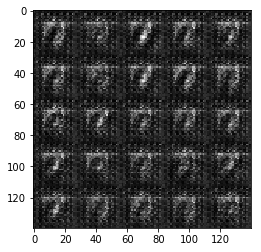

Epoch 1/2... Discriminator Loss: 4.0975... Generator Loss: 0.0391
Epoch 1/2... Discriminator Loss: 3.1109... Generator Loss: 0.0924


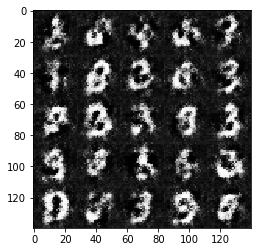

Epoch 1/2... Discriminator Loss: 3.4717... Generator Loss: 0.0596
Epoch 1/2... Discriminator Loss: 2.7929... Generator Loss: 0.1477


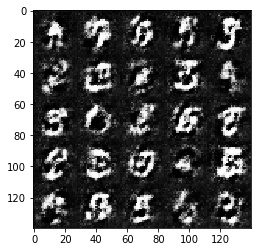

Epoch 1/2... Discriminator Loss: 2.8092... Generator Loss: 0.1407
Epoch 1/2... Discriminator Loss: 2.1162... Generator Loss: 0.8440


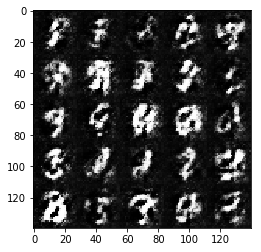

Epoch 1/2... Discriminator Loss: 3.0941... Generator Loss: 0.1020
Epoch 1/2... Discriminator Loss: 2.2518... Generator Loss: 0.5756


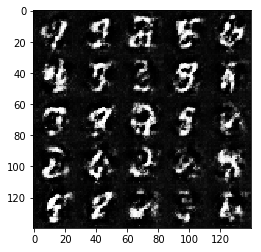

Epoch 1/2... Discriminator Loss: 2.1225... Generator Loss: 0.2209
Epoch 1/2... Discriminator Loss: 1.4604... Generator Loss: 0.6641


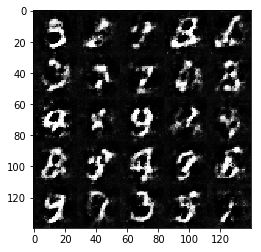

Epoch 1/2... Discriminator Loss: 1.7292... Generator Loss: 0.3324
Epoch 1/2... Discriminator Loss: 1.8320... Generator Loss: 0.3459


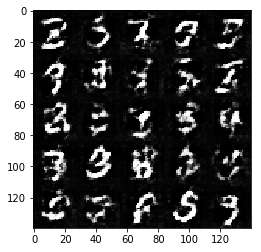

Epoch 1/2... Discriminator Loss: 1.5636... Generator Loss: 0.4092
Epoch 1/2... Discriminator Loss: 1.5949... Generator Loss: 0.6923


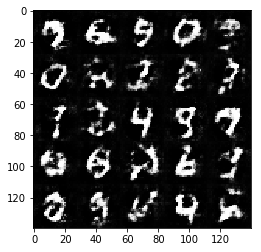

Epoch 1/2... Discriminator Loss: 1.5290... Generator Loss: 0.4339
Epoch 1/2... Discriminator Loss: 2.4117... Generator Loss: 0.1562


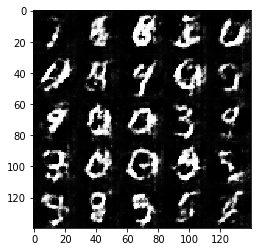

Epoch 1/2... Discriminator Loss: 1.6713... Generator Loss: 0.7614
Epoch 1/2... Discriminator Loss: 1.5274... Generator Loss: 0.6690


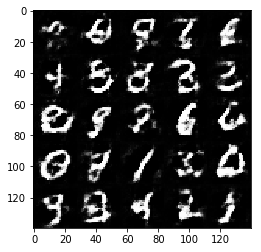

Epoch 1/2... Discriminator Loss: 2.1575... Generator Loss: 0.2355
Epoch 1/2... Discriminator Loss: 1.8655... Generator Loss: 0.6290


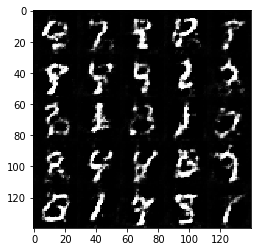

Epoch 1/2... Discriminator Loss: 1.6128... Generator Loss: 0.4190
Epoch 1/2... Discriminator Loss: 1.3627... Generator Loss: 1.0252


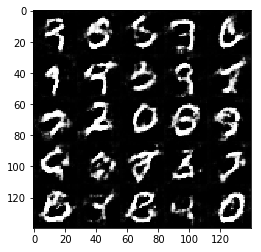

Epoch 1/2... Discriminator Loss: 1.1538... Generator Loss: 1.2890
Epoch 1/2... Discriminator Loss: 1.1246... Generator Loss: 0.7551


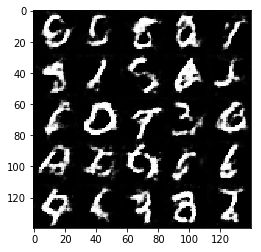

Epoch 1/2... Discriminator Loss: 1.2766... Generator Loss: 0.6039
Epoch 1/2... Discriminator Loss: 0.7532... Generator Loss: 1.4473


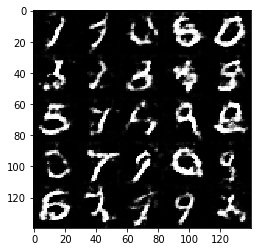

Epoch 1/2... Discriminator Loss: 1.6520... Generator Loss: 1.4028
Epoch 1/2... Discriminator Loss: 1.5216... Generator Loss: 0.7411


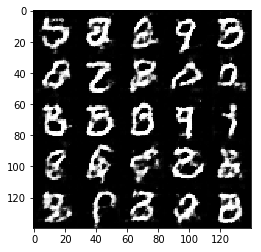

Epoch 1/2... Discriminator Loss: 1.6466... Generator Loss: 0.5535
Epoch 1/2... Discriminator Loss: 1.5578... Generator Loss: 0.4947


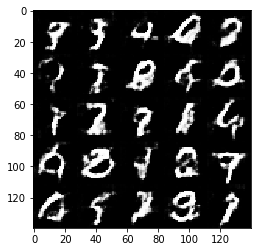

Epoch 1/2... Discriminator Loss: 0.9380... Generator Loss: 1.1972
Epoch 1/2... Discriminator Loss: 1.1755... Generator Loss: 0.8600


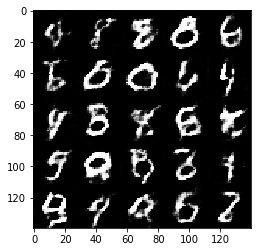

Epoch 1/2... Discriminator Loss: 2.1610... Generator Loss: 0.2207
Epoch 1/2... Discriminator Loss: 1.4876... Generator Loss: 0.5704


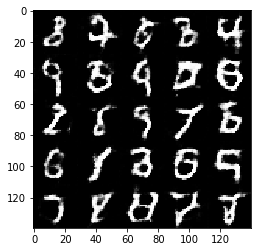

Epoch 1/2... Discriminator Loss: 1.1239... Generator Loss: 0.7874
Epoch 1/2... Discriminator Loss: 1.5288... Generator Loss: 0.5624


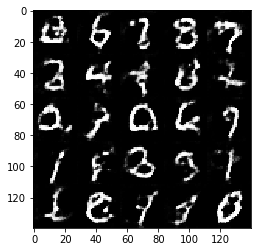

Epoch 1/2... Discriminator Loss: 1.9920... Generator Loss: 0.2539
Epoch 1/2... Discriminator Loss: 1.1754... Generator Loss: 0.7054


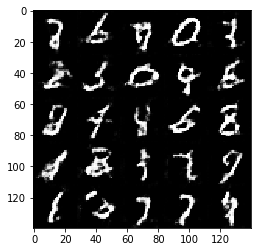

Epoch 1/2... Discriminator Loss: 1.0127... Generator Loss: 1.2552
Epoch 1/2... Discriminator Loss: 1.3268... Generator Loss: 0.6734


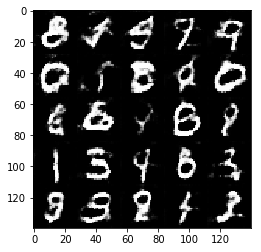

Epoch 1/2... Discriminator Loss: 1.5907... Generator Loss: 0.4153
Epoch 1/2... Discriminator Loss: 1.4543... Generator Loss: 0.6969


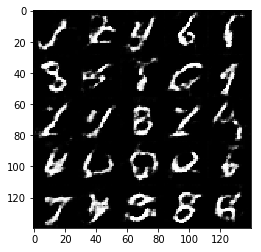

Epoch 1/2... Discriminator Loss: 1.5698... Generator Loss: 0.4804
Epoch 1/2... Discriminator Loss: 0.8416... Generator Loss: 1.0301


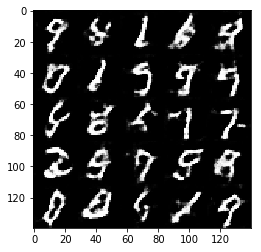

Epoch 1/2... Discriminator Loss: 1.5664... Generator Loss: 0.4375
Epoch 1/2... Discriminator Loss: 1.3742... Generator Loss: 1.0498


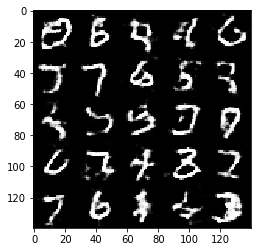

Epoch 1/2... Discriminator Loss: 1.2415... Generator Loss: 0.8665
Epoch 1/2... Discriminator Loss: 0.9763... Generator Loss: 0.8341


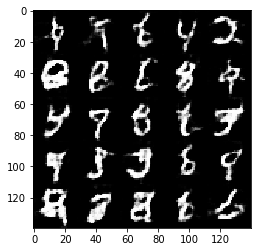

Epoch 1/2... Discriminator Loss: 1.5776... Generator Loss: 0.4993
Epoch 1/2... Discriminator Loss: 1.1032... Generator Loss: 0.7981


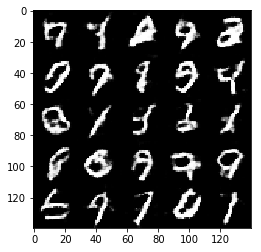

Epoch 1/2... Discriminator Loss: 0.8965... Generator Loss: 0.9710
Epoch 1/2... Discriminator Loss: 1.3032... Generator Loss: 0.9822


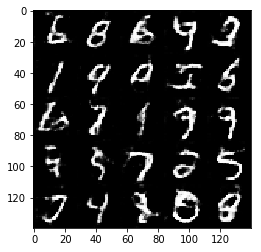

Epoch 1/2... Discriminator Loss: 1.4662... Generator Loss: 0.6029
Epoch 1/2... Discriminator Loss: 1.3723... Generator Loss: 1.4194


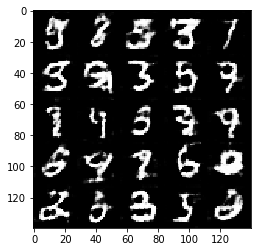

Epoch 1/2... Discriminator Loss: 1.7516... Generator Loss: 0.3651
Epoch 1/2... Discriminator Loss: 0.9769... Generator Loss: 1.3893


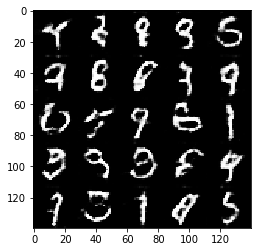

Epoch 1/2... Discriminator Loss: 1.1198... Generator Loss: 0.7950
Epoch 1/2... Discriminator Loss: 1.5101... Generator Loss: 0.4361


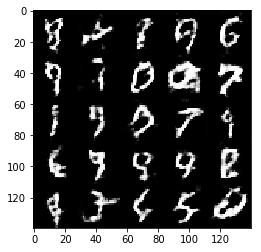

Epoch 1/2... Discriminator Loss: 1.6047... Generator Loss: 0.3951
Epoch 1/2... Discriminator Loss: 1.2394... Generator Loss: 0.8040


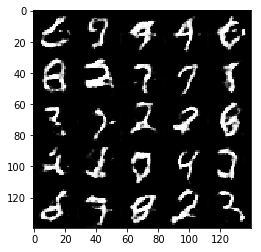

Epoch 1/2... Discriminator Loss: 0.9543... Generator Loss: 0.9330
Epoch 1/2... Discriminator Loss: 1.0416... Generator Loss: 0.9491


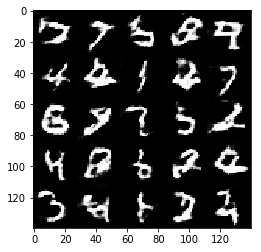

Epoch 1/2... Discriminator Loss: 1.0120... Generator Loss: 1.6767
Epoch 1/2... Discriminator Loss: 1.1864... Generator Loss: 0.7611


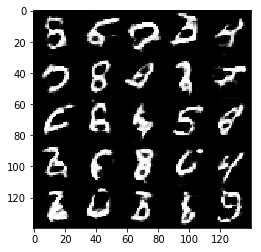

Epoch 1/2... Discriminator Loss: 1.2872... Generator Loss: 0.5840
Epoch 1/2... Discriminator Loss: 0.9140... Generator Loss: 1.2584


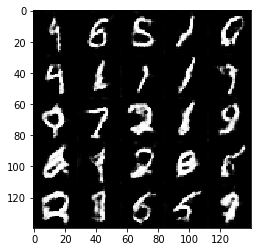

Epoch 1/2... Discriminator Loss: 1.8227... Generator Loss: 0.2660
Epoch 1/2... Discriminator Loss: 1.2999... Generator Loss: 0.6566


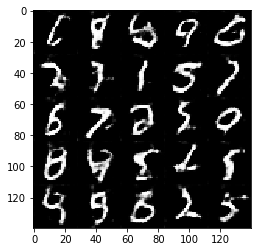

Epoch 1/2... Discriminator Loss: 1.7014... Generator Loss: 0.5533
Epoch 1/2... Discriminator Loss: 1.3929... Generator Loss: 0.5864


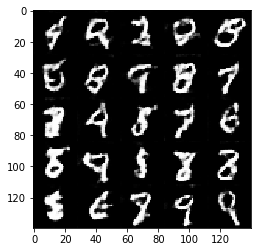

Epoch 1/2... Discriminator Loss: 1.0383... Generator Loss: 1.1344
Epoch 1/2... Discriminator Loss: 1.3206... Generator Loss: 0.9104


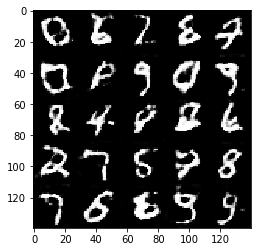

Epoch 1/2... Discriminator Loss: 1.1523... Generator Loss: 1.0526
Epoch 1/2... Discriminator Loss: 1.0064... Generator Loss: 1.3262


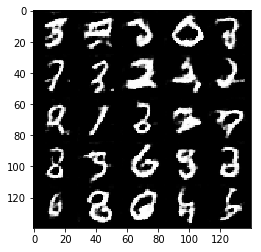

Epoch 1/2... Discriminator Loss: 1.1272... Generator Loss: 0.6118
Epoch 1/2... Discriminator Loss: 0.8642... Generator Loss: 1.1883


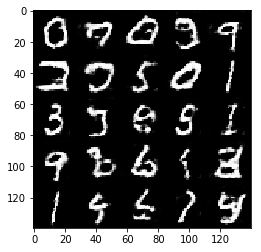

Epoch 1/2... Discriminator Loss: 1.0634... Generator Loss: 1.4064
Epoch 1/2... Discriminator Loss: 0.9298... Generator Loss: 1.6636


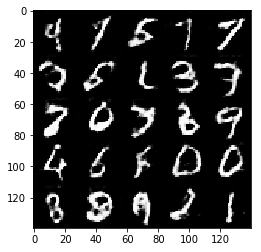

Epoch 1/2... Discriminator Loss: 1.3019... Generator Loss: 1.3303
Epoch 1/2... Discriminator Loss: 1.0689... Generator Loss: 1.4945


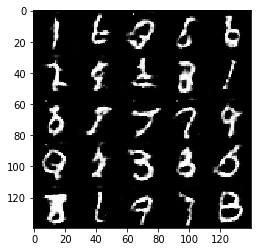

Epoch 1/2... Discriminator Loss: 0.7779... Generator Loss: 2.4150
Epoch 1/2... Discriminator Loss: 1.2547... Generator Loss: 0.7272


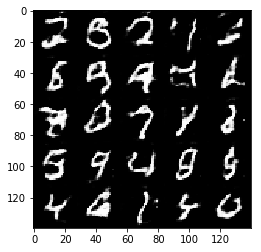

Epoch 1/2... Discriminator Loss: 1.0891... Generator Loss: 0.8116
Epoch 1/2... Discriminator Loss: 0.9924... Generator Loss: 0.8080


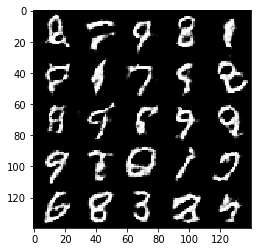

Epoch 1/2... Discriminator Loss: 0.7139... Generator Loss: 1.7004
Epoch 1/2... Discriminator Loss: 1.5265... Generator Loss: 0.4759


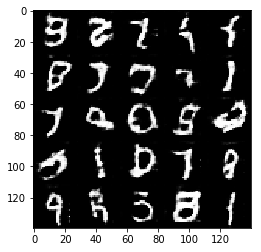

Epoch 1/2... Discriminator Loss: 1.1161... Generator Loss: 0.8801
Epoch 1/2... Discriminator Loss: 0.7222... Generator Loss: 1.2580


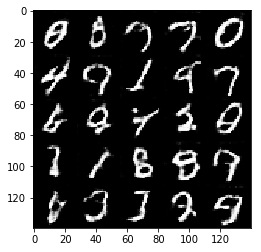

Epoch 1/2... Discriminator Loss: 0.9702... Generator Loss: 0.9982
Epoch 1/2... Discriminator Loss: 0.8720... Generator Loss: 0.9890


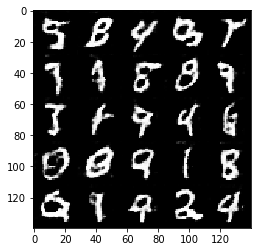

Epoch 1/2... Discriminator Loss: 1.1421... Generator Loss: 0.8566
Epoch 1/2... Discriminator Loss: 1.1248... Generator Loss: 1.6546


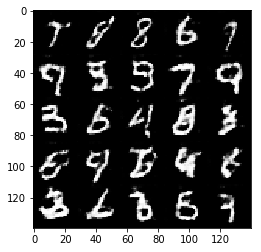

Epoch 1/2... Discriminator Loss: 0.8673... Generator Loss: 0.9747
Epoch 1/2... Discriminator Loss: 0.8898... Generator Loss: 1.1068


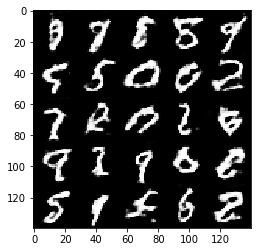

Epoch 1/2... Discriminator Loss: 1.4735... Generator Loss: 0.4633
Epoch 1/2... Discriminator Loss: 1.1071... Generator Loss: 1.2271


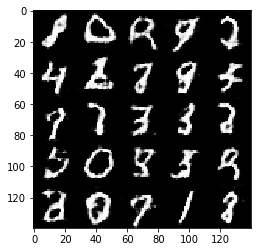

Epoch 1/2... Discriminator Loss: 0.7613... Generator Loss: 1.8658
Epoch 1/2... Discriminator Loss: 1.8675... Generator Loss: 0.3140


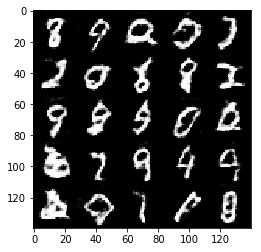

Epoch 1/2... Discriminator Loss: 0.9511... Generator Loss: 0.8805
Epoch 1/2... Discriminator Loss: 0.8827... Generator Loss: 1.2146


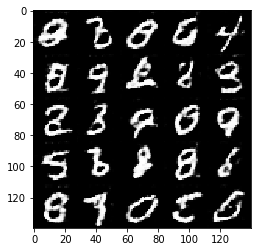

Epoch 1/2... Discriminator Loss: 1.5731... Generator Loss: 0.3908
Epoch 1/2... Discriminator Loss: 0.9546... Generator Loss: 1.0980


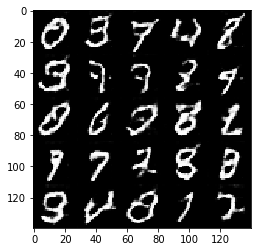

Epoch 1/2... Discriminator Loss: 1.0114... Generator Loss: 0.9231
Epoch 1/2... Discriminator Loss: 0.9885... Generator Loss: 0.8882


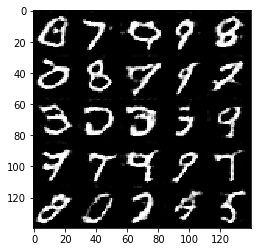

Epoch 1/2... Discriminator Loss: 1.0386... Generator Loss: 0.7716
Epoch 1/2... Discriminator Loss: 1.0049... Generator Loss: 0.7612


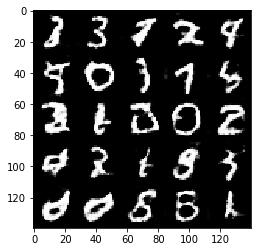

Epoch 1/2... Discriminator Loss: 1.5484... Generator Loss: 0.4239
Epoch 1/2... Discriminator Loss: 1.1754... Generator Loss: 0.7739


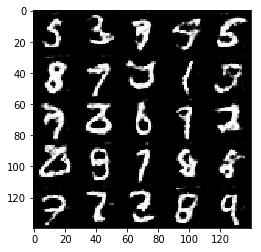

Epoch 1/2... Discriminator Loss: 0.7490... Generator Loss: 1.7320
Epoch 1/2... Discriminator Loss: 0.9074... Generator Loss: 1.1426


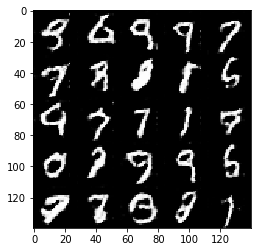

Epoch 1/2... Discriminator Loss: 0.5762... Generator Loss: 1.8096
Epoch 1/2... Discriminator Loss: 0.9997... Generator Loss: 0.8343


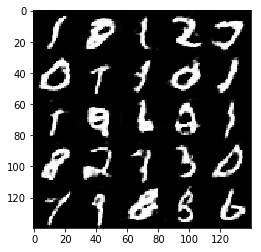

Epoch 1/2... Discriminator Loss: 0.8074... Generator Loss: 1.4116
Epoch 1/2... Discriminator Loss: 1.0730... Generator Loss: 0.6982


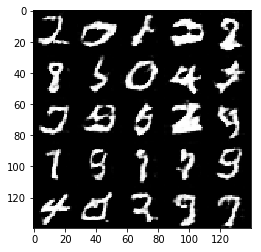

Epoch 1/2... Discriminator Loss: 0.8253... Generator Loss: 1.9963
Epoch 1/2... Discriminator Loss: 0.7073... Generator Loss: 1.7598


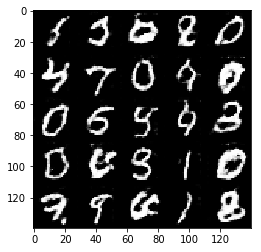

Epoch 1/2... Discriminator Loss: 0.8376... Generator Loss: 2.1517
Epoch 1/2... Discriminator Loss: 1.5408... Generator Loss: 0.5854


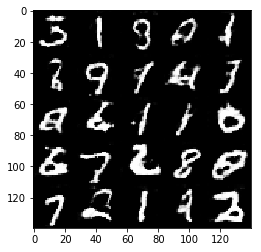

Epoch 2/2... Discriminator Loss: 0.5652... Generator Loss: 1.8739
Epoch 2/2... Discriminator Loss: 0.5540... Generator Loss: 2.6241


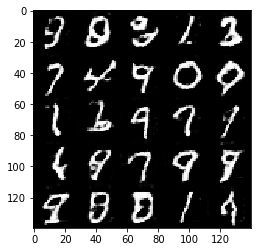

Epoch 2/2... Discriminator Loss: 0.9919... Generator Loss: 0.8158
Epoch 2/2... Discriminator Loss: 0.8340... Generator Loss: 1.3766


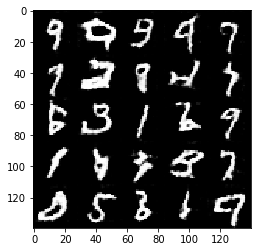

Epoch 2/2... Discriminator Loss: 1.0835... Generator Loss: 0.8947
Epoch 2/2... Discriminator Loss: 0.7230... Generator Loss: 1.5369


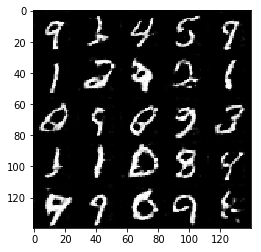

Epoch 2/2... Discriminator Loss: 1.4268... Generator Loss: 0.6357
Epoch 2/2... Discriminator Loss: 1.0714... Generator Loss: 0.8847


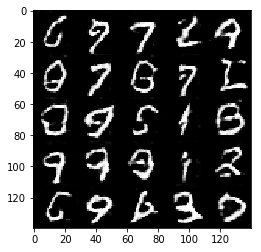

Epoch 2/2... Discriminator Loss: 1.1309... Generator Loss: 0.6635
Epoch 2/2... Discriminator Loss: 0.9206... Generator Loss: 1.3973


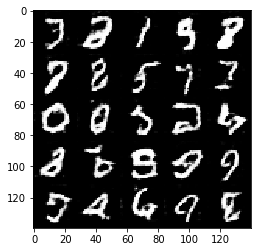

Epoch 2/2... Discriminator Loss: 0.6588... Generator Loss: 1.9159
Epoch 2/2... Discriminator Loss: 1.3576... Generator Loss: 0.5808


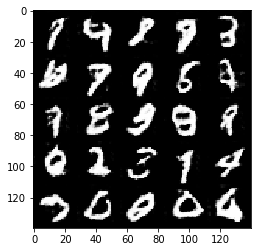

Epoch 2/2... Discriminator Loss: 0.9912... Generator Loss: 0.8315
Epoch 2/2... Discriminator Loss: 1.8938... Generator Loss: 0.2837


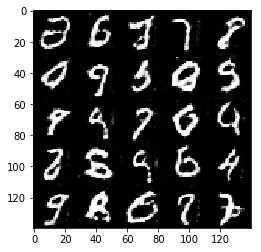

Epoch 2/2... Discriminator Loss: 1.0000... Generator Loss: 0.9493
Epoch 2/2... Discriminator Loss: 0.6791... Generator Loss: 1.9566


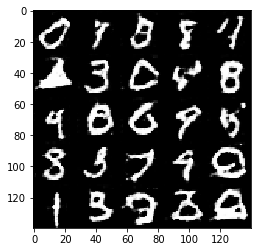

Epoch 2/2... Discriminator Loss: 0.9417... Generator Loss: 1.4089
Epoch 2/2... Discriminator Loss: 1.1657... Generator Loss: 0.6153


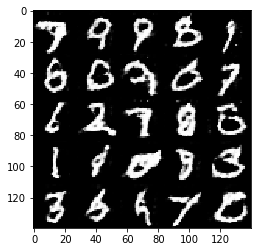

Epoch 2/2... Discriminator Loss: 1.1114... Generator Loss: 0.9508
Epoch 2/2... Discriminator Loss: 0.8371... Generator Loss: 1.4127


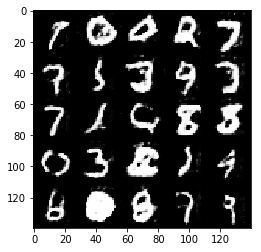

Epoch 2/2... Discriminator Loss: 1.0887... Generator Loss: 0.6881
Epoch 2/2... Discriminator Loss: 0.7782... Generator Loss: 1.6938


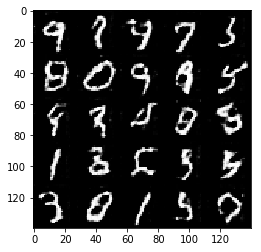

Epoch 2/2... Discriminator Loss: 1.9815... Generator Loss: 0.2734
Epoch 2/2... Discriminator Loss: 2.0957... Generator Loss: 0.2279


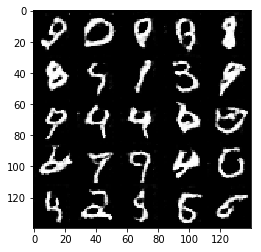

Epoch 2/2... Discriminator Loss: 2.1094... Generator Loss: 0.2244
Epoch 2/2... Discriminator Loss: 0.9982... Generator Loss: 1.6043


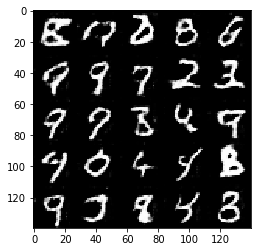

Epoch 2/2... Discriminator Loss: 1.3940... Generator Loss: 0.5069
Epoch 2/2... Discriminator Loss: 0.8486... Generator Loss: 2.4575


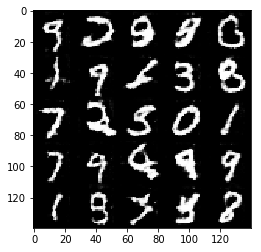

Epoch 2/2... Discriminator Loss: 1.1288... Generator Loss: 0.7094
Epoch 2/2... Discriminator Loss: 1.0937... Generator Loss: 0.7192


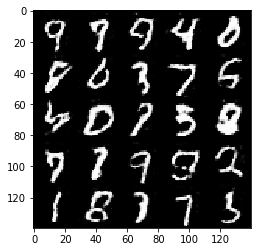

Epoch 2/2... Discriminator Loss: 0.9423... Generator Loss: 0.8337
Epoch 2/2... Discriminator Loss: 0.9750... Generator Loss: 1.2439


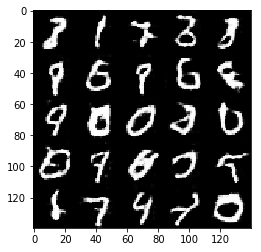

Epoch 2/2... Discriminator Loss: 1.2747... Generator Loss: 0.6944
Epoch 2/2... Discriminator Loss: 1.4071... Generator Loss: 0.4286


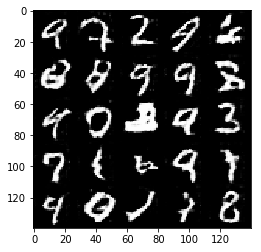

Epoch 2/2... Discriminator Loss: 0.6816... Generator Loss: 1.5501
Epoch 2/2... Discriminator Loss: 1.0288... Generator Loss: 0.9441


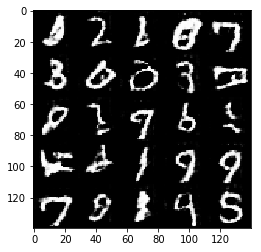

Epoch 2/2... Discriminator Loss: 0.7943... Generator Loss: 1.7142
Epoch 2/2... Discriminator Loss: 0.6610... Generator Loss: 1.7809


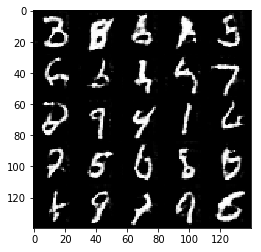

Epoch 2/2... Discriminator Loss: 0.9617... Generator Loss: 0.9125
Epoch 2/2... Discriminator Loss: 1.4606... Generator Loss: 0.4552


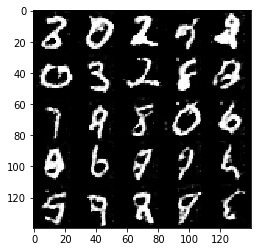

Epoch 2/2... Discriminator Loss: 1.1102... Generator Loss: 0.7781
Epoch 2/2... Discriminator Loss: 1.1523... Generator Loss: 0.6863


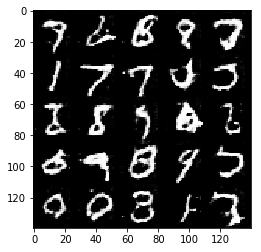

Epoch 2/2... Discriminator Loss: 0.9280... Generator Loss: 1.1568
Epoch 2/2... Discriminator Loss: 1.2775... Generator Loss: 0.5185


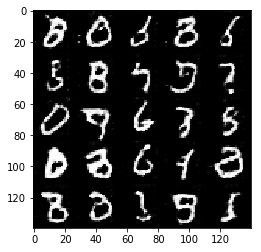

Epoch 2/2... Discriminator Loss: 1.1416... Generator Loss: 0.7359
Epoch 2/2... Discriminator Loss: 1.1238... Generator Loss: 0.7447


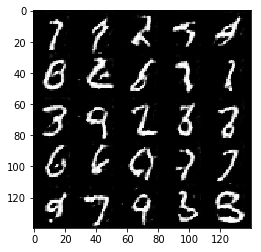

Epoch 2/2... Discriminator Loss: 0.8764... Generator Loss: 1.3320
Epoch 2/2... Discriminator Loss: 0.9411... Generator Loss: 1.0295


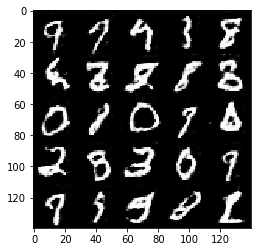

Epoch 2/2... Discriminator Loss: 1.3795... Generator Loss: 0.4969
Epoch 2/2... Discriminator Loss: 0.5848... Generator Loss: 1.6267


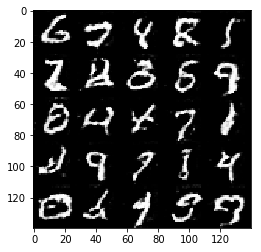

Epoch 2/2... Discriminator Loss: 0.9994... Generator Loss: 1.0210
Epoch 2/2... Discriminator Loss: 1.0502... Generator Loss: 0.9240


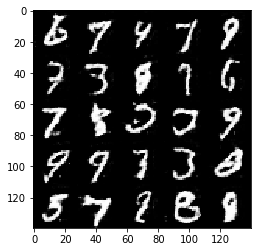

Epoch 2/2... Discriminator Loss: 0.8632... Generator Loss: 1.2325
Epoch 2/2... Discriminator Loss: 1.3355... Generator Loss: 1.1712


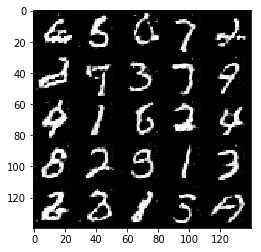

Epoch 2/2... Discriminator Loss: 2.0894... Generator Loss: 0.2426
Epoch 2/2... Discriminator Loss: 0.5892... Generator Loss: 2.0235


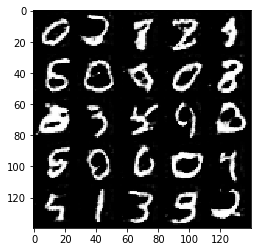

Epoch 2/2... Discriminator Loss: 0.8211... Generator Loss: 1.4646
Epoch 2/2... Discriminator Loss: 1.2891... Generator Loss: 0.5714


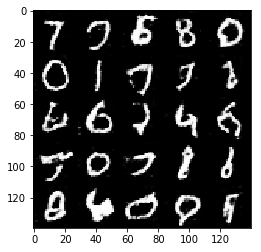

Epoch 2/2... Discriminator Loss: 0.9711... Generator Loss: 0.9356
Epoch 2/2... Discriminator Loss: 1.4600... Generator Loss: 4.3499


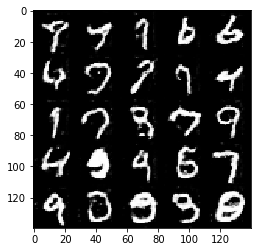

Epoch 2/2... Discriminator Loss: 1.2580... Generator Loss: 0.8839
Epoch 2/2... Discriminator Loss: 1.1822... Generator Loss: 0.6902


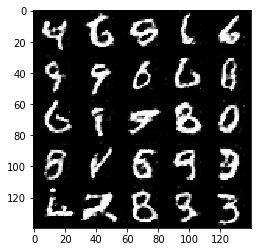

Epoch 2/2... Discriminator Loss: 0.7456... Generator Loss: 2.0310
Epoch 2/2... Discriminator Loss: 0.8539... Generator Loss: 1.1231


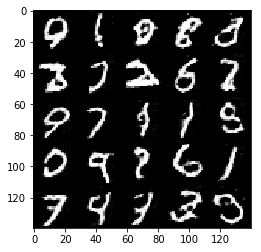

Epoch 2/2... Discriminator Loss: 0.7081... Generator Loss: 1.3930
Epoch 2/2... Discriminator Loss: 1.0440... Generator Loss: 0.8611


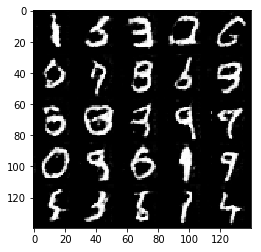

Epoch 2/2... Discriminator Loss: 1.0839... Generator Loss: 0.8504
Epoch 2/2... Discriminator Loss: 0.9536... Generator Loss: 1.1105


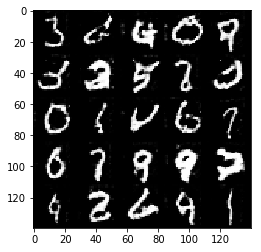

Epoch 2/2... Discriminator Loss: 1.4157... Generator Loss: 0.6877
Epoch 2/2... Discriminator Loss: 1.2444... Generator Loss: 0.7226


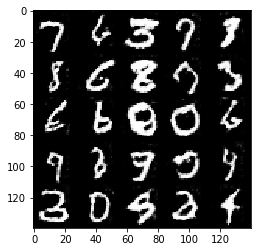

Epoch 2/2... Discriminator Loss: 2.2401... Generator Loss: 0.1930
Epoch 2/2... Discriminator Loss: 1.6114... Generator Loss: 0.3862


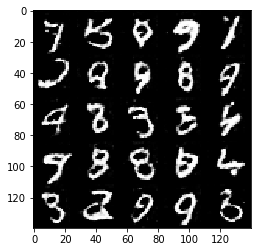

Epoch 2/2... Discriminator Loss: 0.8410... Generator Loss: 1.4245
Epoch 2/2... Discriminator Loss: 0.6875... Generator Loss: 1.9982


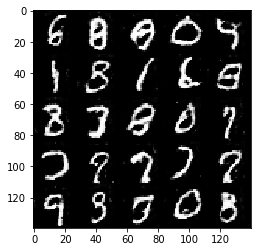

Epoch 2/2... Discriminator Loss: 0.6409... Generator Loss: 1.5851
Epoch 2/2... Discriminator Loss: 1.2723... Generator Loss: 0.6517


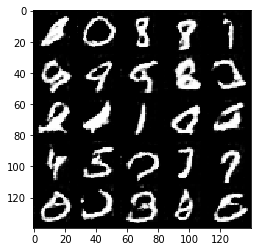

Epoch 2/2... Discriminator Loss: 1.3305... Generator Loss: 0.5292
Epoch 2/2... Discriminator Loss: 0.6278... Generator Loss: 2.1217


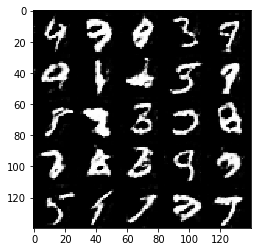

Epoch 2/2... Discriminator Loss: 0.8340... Generator Loss: 1.3197
Epoch 2/2... Discriminator Loss: 1.1679... Generator Loss: 0.7180


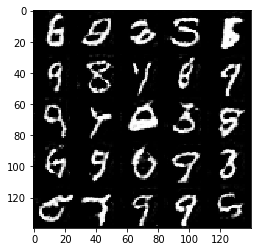

Epoch 2/2... Discriminator Loss: 0.9886... Generator Loss: 0.9250
Epoch 2/2... Discriminator Loss: 1.2680... Generator Loss: 0.7018


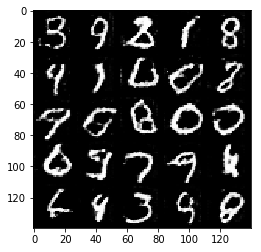

Epoch 2/2... Discriminator Loss: 0.6134... Generator Loss: 2.0131
Epoch 2/2... Discriminator Loss: 1.0470... Generator Loss: 0.8227


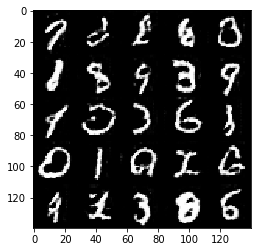

Epoch 2/2... Discriminator Loss: 1.4124... Generator Loss: 0.4789
Epoch 2/2... Discriminator Loss: 1.3934... Generator Loss: 0.6110


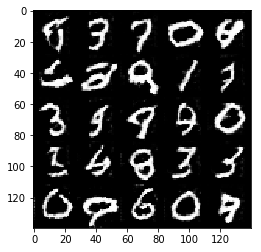

Epoch 2/2... Discriminator Loss: 0.7095... Generator Loss: 1.5324
Epoch 2/2... Discriminator Loss: 1.3157... Generator Loss: 0.6458


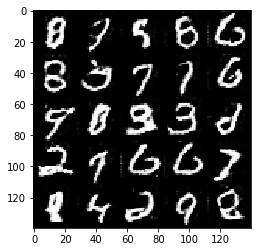

Epoch 2/2... Discriminator Loss: 2.0827... Generator Loss: 0.2526
Epoch 2/2... Discriminator Loss: 0.9649... Generator Loss: 0.9377


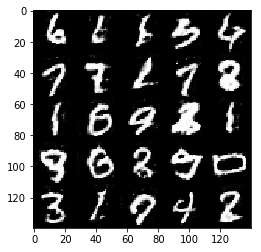

Epoch 2/2... Discriminator Loss: 0.7805... Generator Loss: 1.2260
Epoch 2/2... Discriminator Loss: 0.9535... Generator Loss: 1.1920


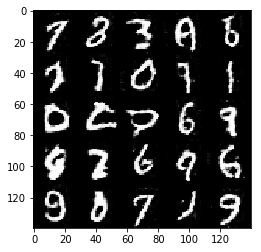

Epoch 2/2... Discriminator Loss: 2.5566... Generator Loss: 0.1972
Epoch 2/2... Discriminator Loss: 0.9611... Generator Loss: 1.0265


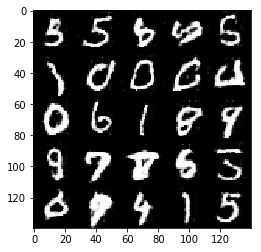

Epoch 2/2... Discriminator Loss: 0.9258... Generator Loss: 1.0152
Epoch 2/2... Discriminator Loss: 1.0932... Generator Loss: 1.0534


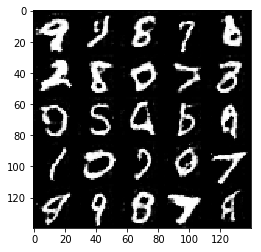

Epoch 2/2... Discriminator Loss: 1.2572... Generator Loss: 0.6638
Epoch 2/2... Discriminator Loss: 0.7804... Generator Loss: 1.5583


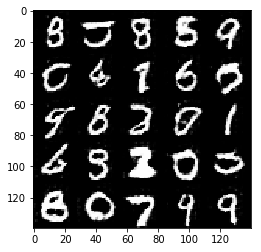

Epoch 2/2... Discriminator Loss: 0.6833... Generator Loss: 1.7972
Epoch 2/2... Discriminator Loss: 1.0089... Generator Loss: 1.6269


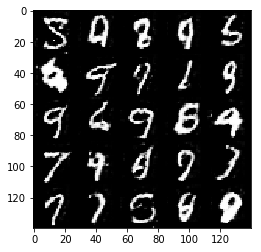

Epoch 2/2... Discriminator Loss: 1.0174... Generator Loss: 1.0657
Epoch 2/2... Discriminator Loss: 1.4707... Generator Loss: 0.5375


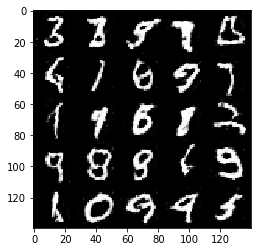

Epoch 2/2... Discriminator Loss: 0.8790... Generator Loss: 1.0970
Epoch 2/2... Discriminator Loss: 1.2018... Generator Loss: 0.8075


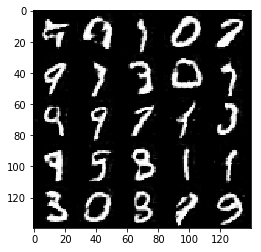

Epoch 2/2... Discriminator Loss: 1.2848... Generator Loss: 0.5529
Epoch 2/2... Discriminator Loss: 0.9461... Generator Loss: 1.1432


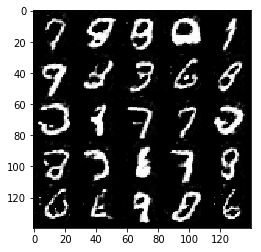

Epoch 2/2... Discriminator Loss: 1.0310... Generator Loss: 1.1544
Epoch 2/2... Discriminator Loss: 0.6544... Generator Loss: 1.6086


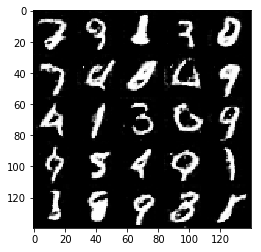

Epoch 2/2... Discriminator Loss: 1.0652... Generator Loss: 0.9309
Epoch 2/2... Discriminator Loss: 0.9835... Generator Loss: 1.3204


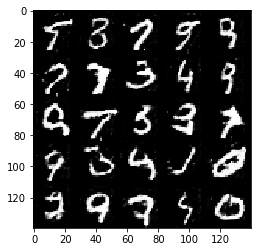

Epoch 2/2... Discriminator Loss: 1.0256... Generator Loss: 2.9062
Epoch 2/2... Discriminator Loss: 1.0667... Generator Loss: 1.9440


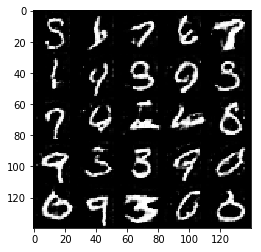

Epoch 2/2... Discriminator Loss: 0.6874... Generator Loss: 1.6183
Epoch 2/2... Discriminator Loss: 1.0756... Generator Loss: 1.0031


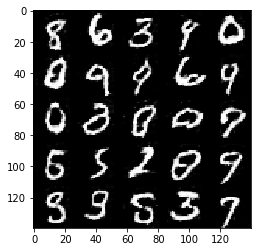

Epoch 2/2... Discriminator Loss: 0.8618... Generator Loss: 1.2376
Epoch 2/2... Discriminator Loss: 0.6318... Generator Loss: 1.6851


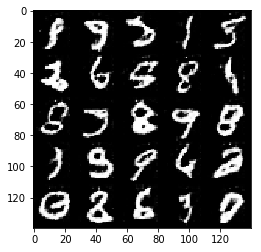

Epoch 2/2... Discriminator Loss: 0.7609... Generator Loss: 1.6413
Epoch 2/2... Discriminator Loss: 0.9904... Generator Loss: 1.1778


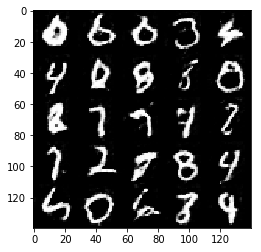

Epoch 2/2... Discriminator Loss: 0.6874... Generator Loss: 1.7205
Epoch 2/2... Discriminator Loss: 1.3412... Generator Loss: 0.4658


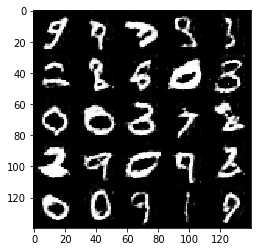

In [13]:
batch_size = 5
z_dim = 100
learning_rate = 0.0002
beta1 = 0.2


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 2

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
Run your GANs on CelebA.  It will take around 20 minutes on the average GPU to run one epoch.  You can run the whole epoch or stop when it starts to generate realistic faces.

Epoch 1/1... Discriminator Loss: 4.0549... Generator Loss: 0.0428
Epoch 1/1... Discriminator Loss: 2.5486... Generator Loss: 0.2685


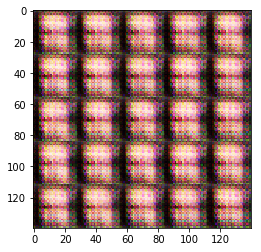

Epoch 1/1... Discriminator Loss: 1.6137... Generator Loss: 0.5862
Epoch 1/1... Discriminator Loss: 1.8533... Generator Loss: 0.4951


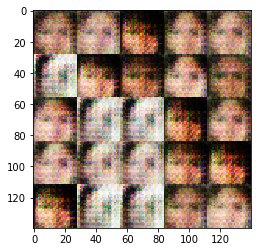

Epoch 1/1... Discriminator Loss: 1.1769... Generator Loss: 0.9449
Epoch 1/1... Discriminator Loss: 1.4830... Generator Loss: 0.7688


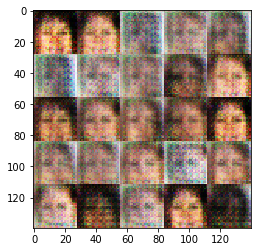

Epoch 1/1... Discriminator Loss: 1.4476... Generator Loss: 0.6365
Epoch 1/1... Discriminator Loss: 1.6667... Generator Loss: 0.5262


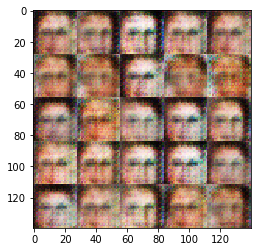

Epoch 1/1... Discriminator Loss: 1.3653... Generator Loss: 0.6492
Epoch 1/1... Discriminator Loss: 1.8402... Generator Loss: 0.4198


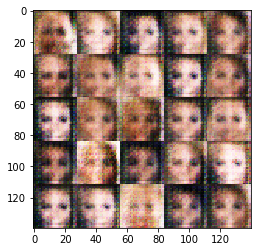

Epoch 1/1... Discriminator Loss: 1.5188... Generator Loss: 0.7341
Epoch 1/1... Discriminator Loss: 1.4969... Generator Loss: 0.8090


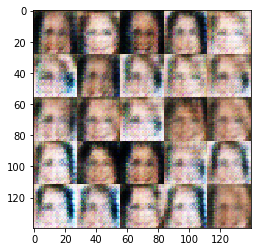

Epoch 1/1... Discriminator Loss: 1.1574... Generator Loss: 1.2130
Epoch 1/1... Discriminator Loss: 1.4324... Generator Loss: 0.7532


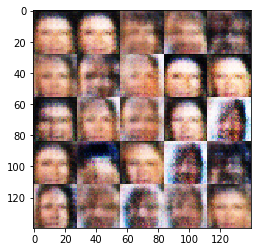

Epoch 1/1... Discriminator Loss: 1.5189... Generator Loss: 0.6371
Epoch 1/1... Discriminator Loss: 1.2542... Generator Loss: 0.9022


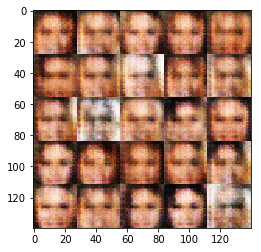

Epoch 1/1... Discriminator Loss: 1.4014... Generator Loss: 0.5844
Epoch 1/1... Discriminator Loss: 1.3193... Generator Loss: 0.8770


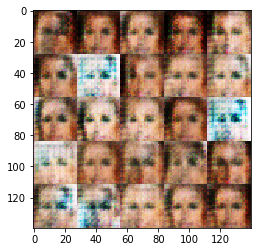

Epoch 1/1... Discriminator Loss: 1.4796... Generator Loss: 0.6717
Epoch 1/1... Discriminator Loss: 1.1498... Generator Loss: 0.8193


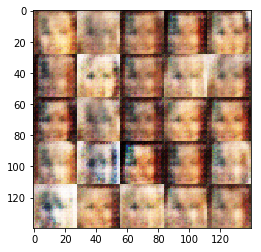

Epoch 1/1... Discriminator Loss: 1.0594... Generator Loss: 1.0389
Epoch 1/1... Discriminator Loss: 1.1423... Generator Loss: 0.9991


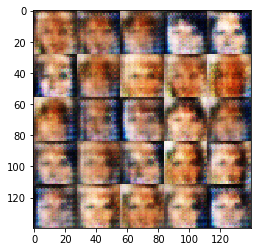

Epoch 1/1... Discriminator Loss: 1.2690... Generator Loss: 0.8009
Epoch 1/1... Discriminator Loss: 1.2206... Generator Loss: 0.7954


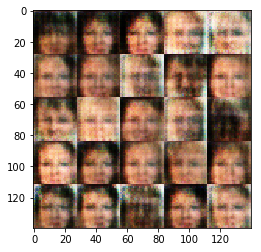

Epoch 1/1... Discriminator Loss: 1.3463... Generator Loss: 1.0020
Epoch 1/1... Discriminator Loss: 0.9269... Generator Loss: 1.1133


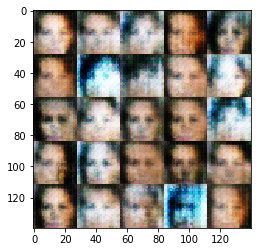

Epoch 1/1... Discriminator Loss: 1.9806... Generator Loss: 0.7763
Epoch 1/1... Discriminator Loss: 1.1983... Generator Loss: 0.9882


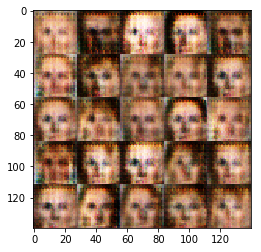

Epoch 1/1... Discriminator Loss: 1.6901... Generator Loss: 0.6876
Epoch 1/1... Discriminator Loss: 1.4213... Generator Loss: 0.7379


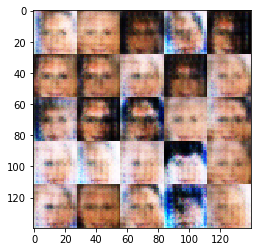

Epoch 1/1... Discriminator Loss: 1.2980... Generator Loss: 0.8537
Epoch 1/1... Discriminator Loss: 1.6950... Generator Loss: 0.5152


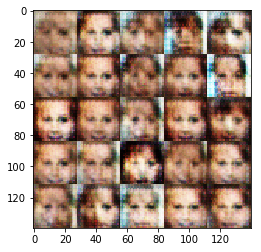

Epoch 1/1... Discriminator Loss: 1.3185... Generator Loss: 0.6811
Epoch 1/1... Discriminator Loss: 1.0060... Generator Loss: 1.1760


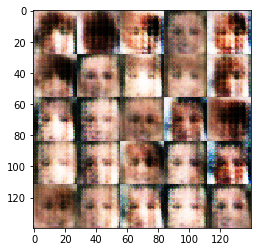

Epoch 1/1... Discriminator Loss: 1.1034... Generator Loss: 1.0767
Epoch 1/1... Discriminator Loss: 1.2007... Generator Loss: 0.8574


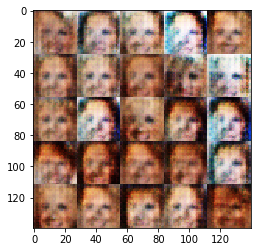

Epoch 1/1... Discriminator Loss: 1.2373... Generator Loss: 0.7291
Epoch 1/1... Discriminator Loss: 1.2310... Generator Loss: 0.8575


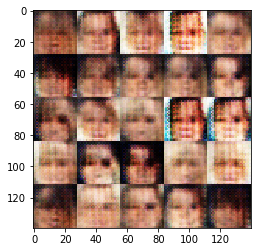

Epoch 1/1... Discriminator Loss: 1.2939... Generator Loss: 0.9328
Epoch 1/1... Discriminator Loss: 1.3495... Generator Loss: 1.5911


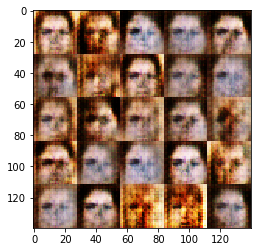

Epoch 1/1... Discriminator Loss: 1.2036... Generator Loss: 0.9547
Epoch 1/1... Discriminator Loss: 1.1338... Generator Loss: 0.8389


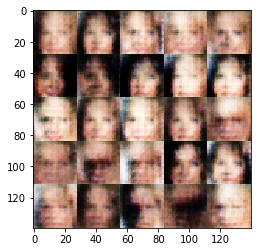

Epoch 1/1... Discriminator Loss: 1.3508... Generator Loss: 0.9568
Epoch 1/1... Discriminator Loss: 1.2057... Generator Loss: 1.1132


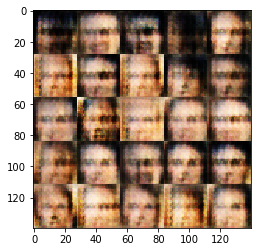

Epoch 1/1... Discriminator Loss: 1.0248... Generator Loss: 1.0592
Epoch 1/1... Discriminator Loss: 0.9993... Generator Loss: 0.8739


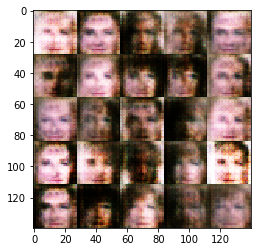

Epoch 1/1... Discriminator Loss: 1.2766... Generator Loss: 0.7795
Epoch 1/1... Discriminator Loss: 1.3416... Generator Loss: 0.7557


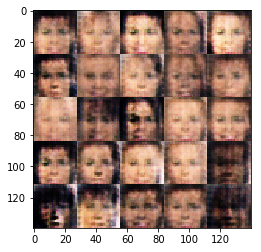

Epoch 1/1... Discriminator Loss: 0.9734... Generator Loss: 0.9872
Epoch 1/1... Discriminator Loss: 1.0707... Generator Loss: 1.0480


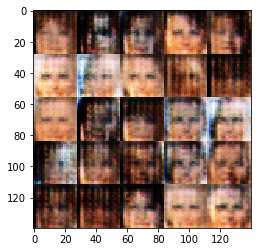

Epoch 1/1... Discriminator Loss: 1.0949... Generator Loss: 1.1703
Epoch 1/1... Discriminator Loss: 1.3541... Generator Loss: 1.4304


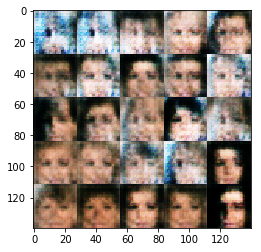

Epoch 1/1... Discriminator Loss: 1.2146... Generator Loss: 1.0957
Epoch 1/1... Discriminator Loss: 0.8853... Generator Loss: 1.0746


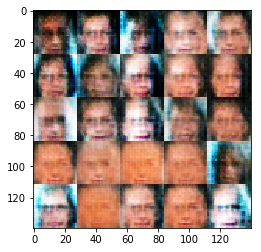

Epoch 1/1... Discriminator Loss: 1.2099... Generator Loss: 0.9956
Epoch 1/1... Discriminator Loss: 0.9391... Generator Loss: 0.9096


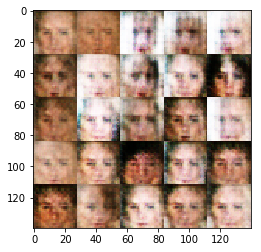

Epoch 1/1... Discriminator Loss: 1.2755... Generator Loss: 0.9445
Epoch 1/1... Discriminator Loss: 1.2923... Generator Loss: 0.7319


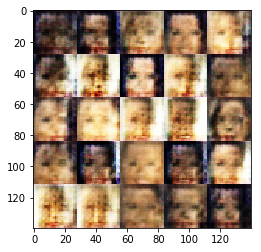

Epoch 1/1... Discriminator Loss: 1.4722... Generator Loss: 0.9918
Epoch 1/1... Discriminator Loss: 1.1895... Generator Loss: 0.9306


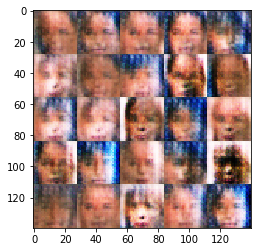

Epoch 1/1... Discriminator Loss: 1.0795... Generator Loss: 1.0890
Epoch 1/1... Discriminator Loss: 0.8685... Generator Loss: 1.1024


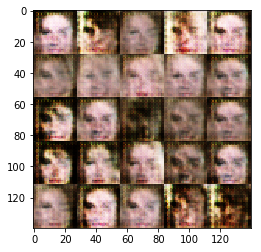

Epoch 1/1... Discriminator Loss: 1.1640... Generator Loss: 0.9700
Epoch 1/1... Discriminator Loss: 1.1583... Generator Loss: 0.9086


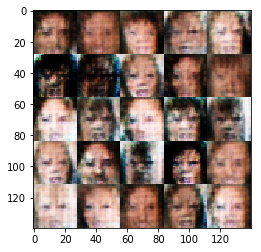

Epoch 1/1... Discriminator Loss: 1.2204... Generator Loss: 0.9936
Epoch 1/1... Discriminator Loss: 0.9152... Generator Loss: 1.0399


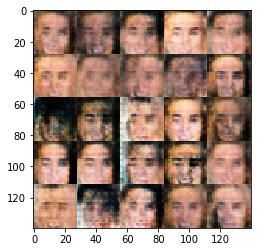

Epoch 1/1... Discriminator Loss: 1.1822... Generator Loss: 0.7449
Epoch 1/1... Discriminator Loss: 0.9734... Generator Loss: 1.2670


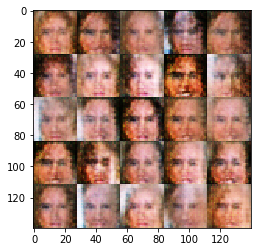

Epoch 1/1... Discriminator Loss: 1.3863... Generator Loss: 0.7451
Epoch 1/1... Discriminator Loss: 1.2040... Generator Loss: 0.6484


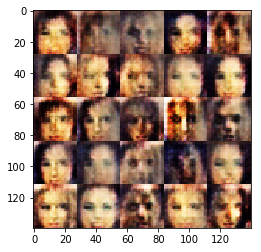

Epoch 1/1... Discriminator Loss: 1.0488... Generator Loss: 1.2829
Epoch 1/1... Discriminator Loss: 1.4375... Generator Loss: 0.8917


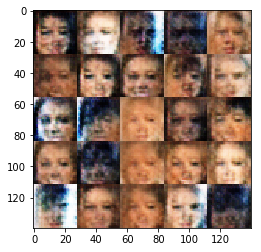

Epoch 1/1... Discriminator Loss: 1.3654... Generator Loss: 0.7215
Epoch 1/1... Discriminator Loss: 1.3434... Generator Loss: 0.7507


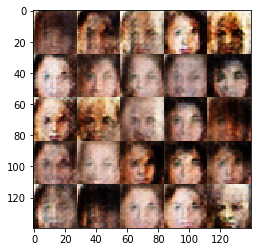

Epoch 1/1... Discriminator Loss: 1.1327... Generator Loss: 1.0496
Epoch 1/1... Discriminator Loss: 1.6101... Generator Loss: 0.5527


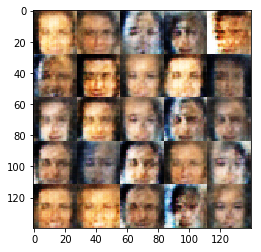

Epoch 1/1... Discriminator Loss: 1.2954... Generator Loss: 0.7437
Epoch 1/1... Discriminator Loss: 1.3012... Generator Loss: 0.9407


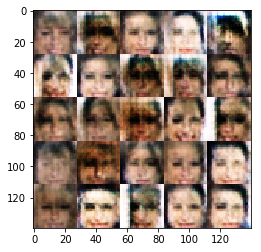

Epoch 1/1... Discriminator Loss: 1.2461... Generator Loss: 0.9644
Epoch 1/1... Discriminator Loss: 1.0083... Generator Loss: 0.9675


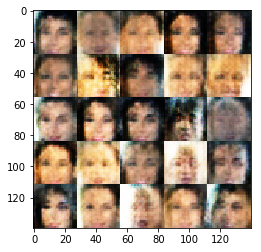

Epoch 1/1... Discriminator Loss: 0.7974... Generator Loss: 1.6048
Epoch 1/1... Discriminator Loss: 0.9414... Generator Loss: 1.0229


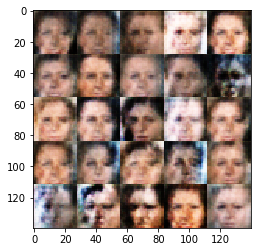

Epoch 1/1... Discriminator Loss: 1.3310... Generator Loss: 0.8526
Epoch 1/1... Discriminator Loss: 1.0363... Generator Loss: 1.0349


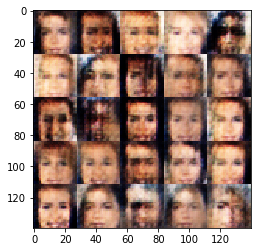

Epoch 1/1... Discriminator Loss: 0.8978... Generator Loss: 1.1976
Epoch 1/1... Discriminator Loss: 1.6908... Generator Loss: 0.4254


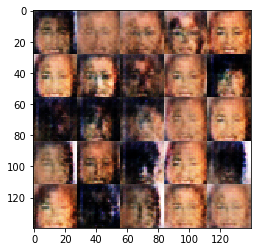

Epoch 1/1... Discriminator Loss: 0.7421... Generator Loss: 1.4243
Epoch 1/1... Discriminator Loss: 1.4152... Generator Loss: 0.7681


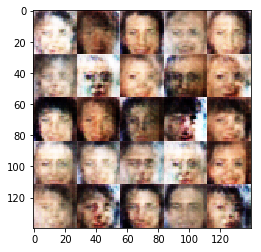

Epoch 1/1... Discriminator Loss: 1.2047... Generator Loss: 0.8095
Epoch 1/1... Discriminator Loss: 1.6330... Generator Loss: 0.7706


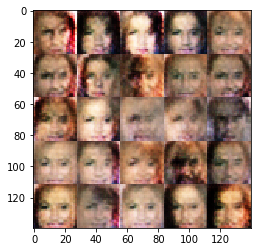

Epoch 1/1... Discriminator Loss: 1.2293... Generator Loss: 1.1164
Epoch 1/1... Discriminator Loss: 0.9953... Generator Loss: 0.9595


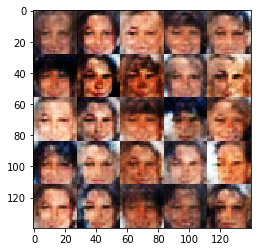

Epoch 1/1... Discriminator Loss: 1.0619... Generator Loss: 1.0387
Epoch 1/1... Discriminator Loss: 0.8965... Generator Loss: 1.6952


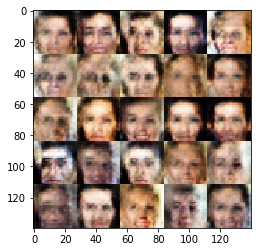

Epoch 1/1... Discriminator Loss: 0.6555... Generator Loss: 1.5787
Epoch 1/1... Discriminator Loss: 1.3998... Generator Loss: 0.6211


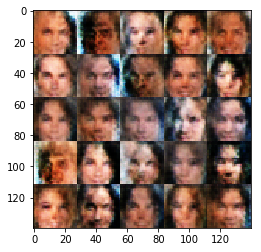

Epoch 1/1... Discriminator Loss: 1.3995... Generator Loss: 0.8478
Epoch 1/1... Discriminator Loss: 1.8492... Generator Loss: 0.4117


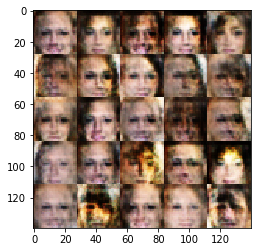

Epoch 1/1... Discriminator Loss: 1.2059... Generator Loss: 0.7403
Epoch 1/1... Discriminator Loss: 1.3127... Generator Loss: 0.8242


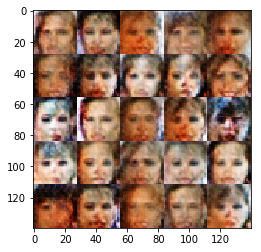

Epoch 1/1... Discriminator Loss: 1.8191... Generator Loss: 0.5482
Epoch 1/1... Discriminator Loss: 1.0432... Generator Loss: 1.0942


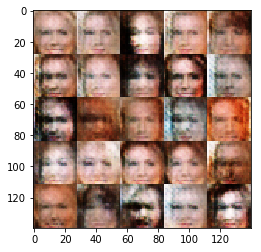

Epoch 1/1... Discriminator Loss: 1.3720... Generator Loss: 0.8699
Epoch 1/1... Discriminator Loss: 0.6971... Generator Loss: 1.3555


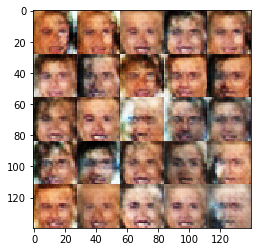

Epoch 1/1... Discriminator Loss: 0.8783... Generator Loss: 1.1667
Epoch 1/1... Discriminator Loss: 1.1657... Generator Loss: 0.9119


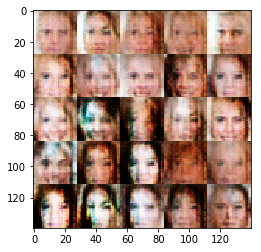

Epoch 1/1... Discriminator Loss: 1.2949... Generator Loss: 0.8864
Epoch 1/1... Discriminator Loss: 1.5956... Generator Loss: 0.8734


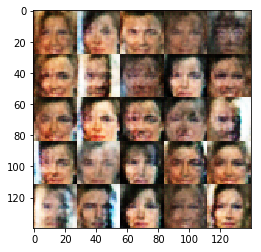

Epoch 1/1... Discriminator Loss: 0.6991... Generator Loss: 1.5123
Epoch 1/1... Discriminator Loss: 0.6496... Generator Loss: 1.5738


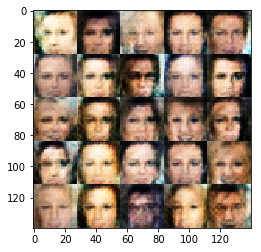

Epoch 1/1... Discriminator Loss: 1.2164... Generator Loss: 0.7979
Epoch 1/1... Discriminator Loss: 1.3860... Generator Loss: 0.7827


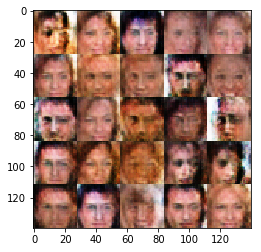

Epoch 1/1... Discriminator Loss: 1.2440... Generator Loss: 0.8025
Epoch 1/1... Discriminator Loss: 0.7732... Generator Loss: 1.1887


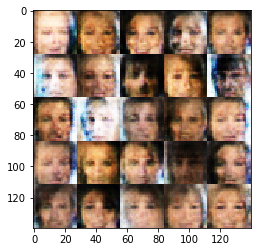

Epoch 1/1... Discriminator Loss: 0.6446... Generator Loss: 1.7585
Epoch 1/1... Discriminator Loss: 1.3193... Generator Loss: 0.6311


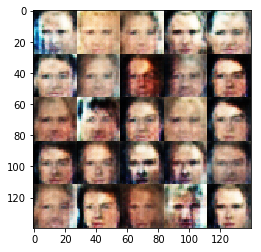

Epoch 1/1... Discriminator Loss: 0.9741... Generator Loss: 1.1241
Epoch 1/1... Discriminator Loss: 1.3672... Generator Loss: 0.5396


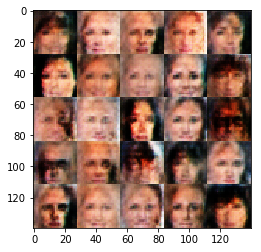

Epoch 1/1... Discriminator Loss: 1.0662... Generator Loss: 1.1744
Epoch 1/1... Discriminator Loss: 0.6651... Generator Loss: 1.4416


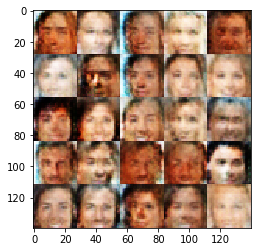

Epoch 1/1... Discriminator Loss: 1.3909... Generator Loss: 1.0015
Epoch 1/1... Discriminator Loss: 0.9185... Generator Loss: 1.0379


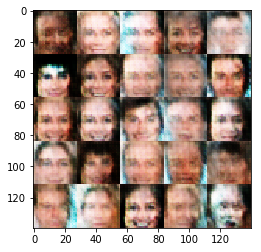

Epoch 1/1... Discriminator Loss: 1.2392... Generator Loss: 0.7296
Epoch 1/1... Discriminator Loss: 0.8657... Generator Loss: 1.2832


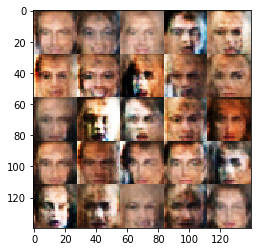

Epoch 1/1... Discriminator Loss: 0.9158... Generator Loss: 1.0720
Epoch 1/1... Discriminator Loss: 0.8828... Generator Loss: 1.3848


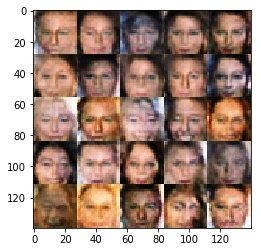

Epoch 1/1... Discriminator Loss: 1.1548... Generator Loss: 1.3857
Epoch 1/1... Discriminator Loss: 1.3496... Generator Loss: 1.1336


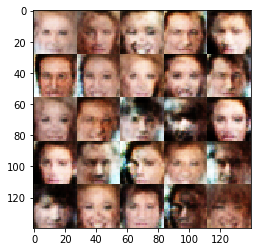

Epoch 1/1... Discriminator Loss: 0.9326... Generator Loss: 1.3065
Epoch 1/1... Discriminator Loss: 0.8697... Generator Loss: 1.2332


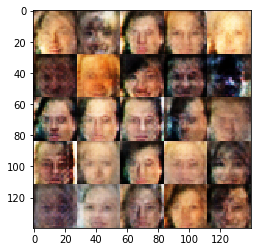

Epoch 1/1... Discriminator Loss: 1.6324... Generator Loss: 0.9626
Epoch 1/1... Discriminator Loss: 1.0834... Generator Loss: 1.2088


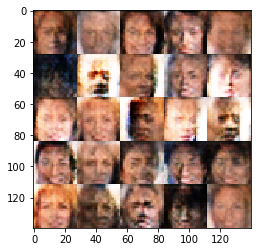

Epoch 1/1... Discriminator Loss: 1.5692... Generator Loss: 0.5885
Epoch 1/1... Discriminator Loss: 1.0696... Generator Loss: 1.0645


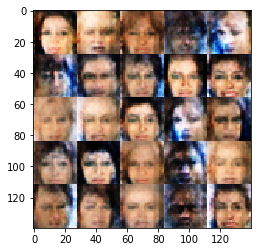

Epoch 1/1... Discriminator Loss: 1.0333... Generator Loss: 0.8395
Epoch 1/1... Discriminator Loss: 1.3505... Generator Loss: 0.7334


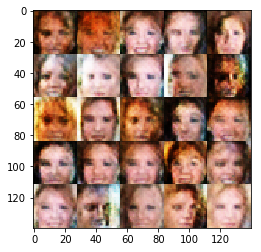

Epoch 1/1... Discriminator Loss: 0.8786... Generator Loss: 1.1016
Epoch 1/1... Discriminator Loss: 0.9592... Generator Loss: 1.2352


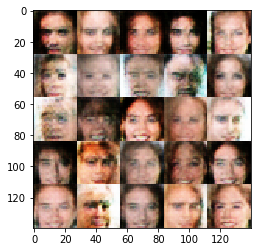

Epoch 1/1... Discriminator Loss: 1.4934... Generator Loss: 1.0940
Epoch 1/1... Discriminator Loss: 0.6907... Generator Loss: 1.4527


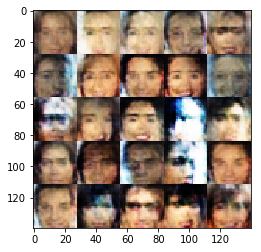

Epoch 1/1... Discriminator Loss: 1.1122... Generator Loss: 0.9811
Epoch 1/1... Discriminator Loss: 1.1123... Generator Loss: 1.2999


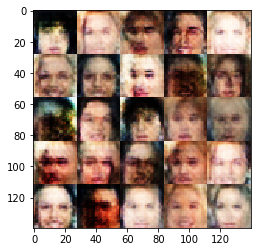

Epoch 1/1... Discriminator Loss: 0.7693... Generator Loss: 1.3942
Epoch 1/1... Discriminator Loss: 1.7308... Generator Loss: 1.0640


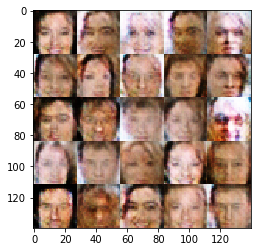

Epoch 1/1... Discriminator Loss: 0.6294... Generator Loss: 1.4874
Epoch 1/1... Discriminator Loss: 1.2031... Generator Loss: 0.8913


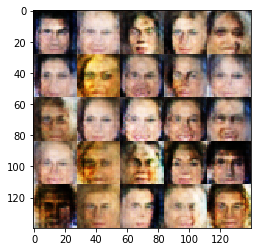

Epoch 1/1... Discriminator Loss: 0.9661... Generator Loss: 1.3196
Epoch 1/1... Discriminator Loss: 0.7645... Generator Loss: 1.3807


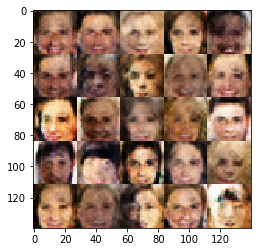

Epoch 1/1... Discriminator Loss: 0.9764... Generator Loss: 1.2474
Epoch 1/1... Discriminator Loss: 1.2847... Generator Loss: 0.8711


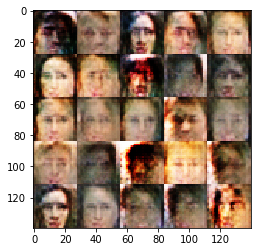

Epoch 1/1... Discriminator Loss: 0.6365... Generator Loss: 1.4582
Epoch 1/1... Discriminator Loss: 0.9417... Generator Loss: 1.2675


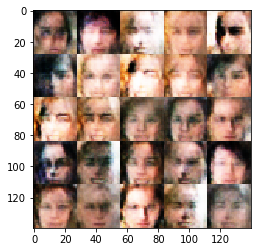

Epoch 1/1... Discriminator Loss: 1.0600... Generator Loss: 0.9015
Epoch 1/1... Discriminator Loss: 0.7497... Generator Loss: 1.8836


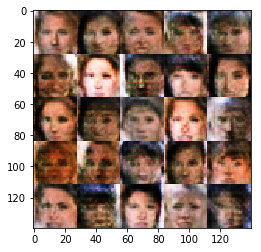

Epoch 1/1... Discriminator Loss: 1.2918... Generator Loss: 1.1386
Epoch 1/1... Discriminator Loss: 1.4771... Generator Loss: 0.9036


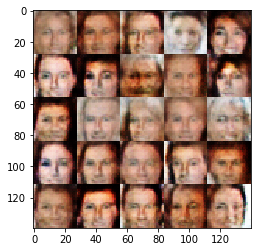

Epoch 1/1... Discriminator Loss: 1.0757... Generator Loss: 0.9130
Epoch 1/1... Discriminator Loss: 1.5793... Generator Loss: 0.6219


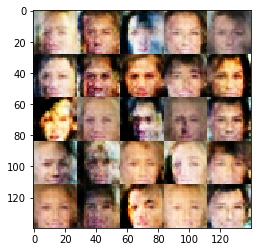

Epoch 1/1... Discriminator Loss: 0.8172... Generator Loss: 1.5454
Epoch 1/1... Discriminator Loss: 0.9382... Generator Loss: 1.0541


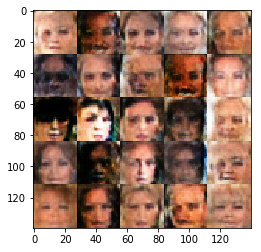

Epoch 1/1... Discriminator Loss: 0.7126... Generator Loss: 1.4044
Epoch 1/1... Discriminator Loss: 0.9347... Generator Loss: 1.1255


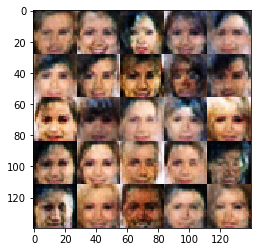

Epoch 1/1... Discriminator Loss: 0.9696... Generator Loss: 1.2993
Epoch 1/1... Discriminator Loss: 1.4388... Generator Loss: 0.6939


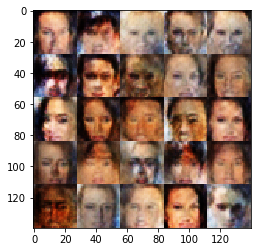

Epoch 1/1... Discriminator Loss: 0.7994... Generator Loss: 1.1007
Epoch 1/1... Discriminator Loss: 1.3760... Generator Loss: 0.6123


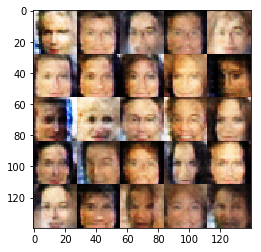

Epoch 1/1... Discriminator Loss: 0.9412... Generator Loss: 0.9923
Epoch 1/1... Discriminator Loss: 0.6407... Generator Loss: 1.7542


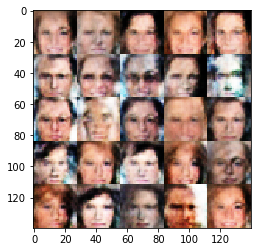

Epoch 1/1... Discriminator Loss: 1.1526... Generator Loss: 0.8779
Epoch 1/1... Discriminator Loss: 0.8759... Generator Loss: 0.9937


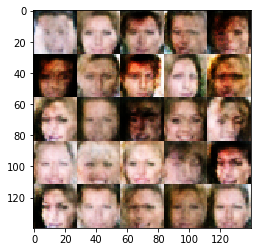

Epoch 1/1... Discriminator Loss: 1.1828... Generator Loss: 1.3237
Epoch 1/1... Discriminator Loss: 0.9227... Generator Loss: 1.5459


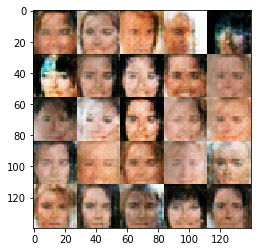

Epoch 1/1... Discriminator Loss: 1.0860... Generator Loss: 1.0385
Epoch 1/1... Discriminator Loss: 1.0702... Generator Loss: 0.9551


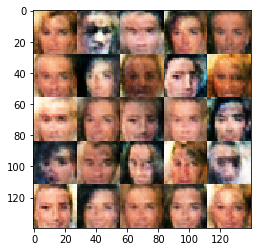

Epoch 1/1... Discriminator Loss: 0.6311... Generator Loss: 1.5704
Epoch 1/1... Discriminator Loss: 0.6991... Generator Loss: 1.4536


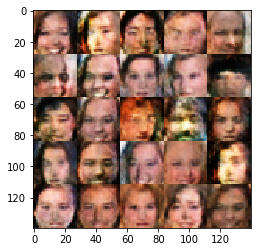

Epoch 1/1... Discriminator Loss: 0.7747... Generator Loss: 1.1965
Epoch 1/1... Discriminator Loss: 1.7262... Generator Loss: 1.2498


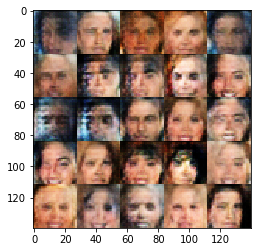

Epoch 1/1... Discriminator Loss: 1.2443... Generator Loss: 0.7454
Epoch 1/1... Discriminator Loss: 1.1076... Generator Loss: 1.1107


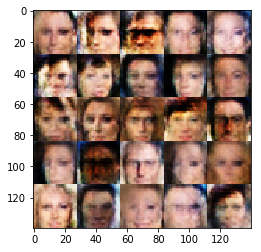

Epoch 1/1... Discriminator Loss: 1.2584... Generator Loss: 0.8972
Epoch 1/1... Discriminator Loss: 1.3661... Generator Loss: 0.5499


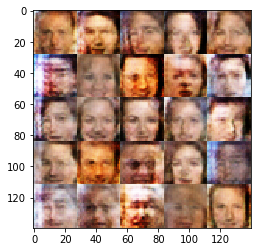

Epoch 1/1... Discriminator Loss: 1.3543... Generator Loss: 0.5444
Epoch 1/1... Discriminator Loss: 1.1565... Generator Loss: 1.2417


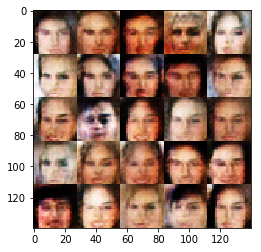

Epoch 1/1... Discriminator Loss: 0.7533... Generator Loss: 1.3650
Epoch 1/1... Discriminator Loss: 0.9630... Generator Loss: 1.0549


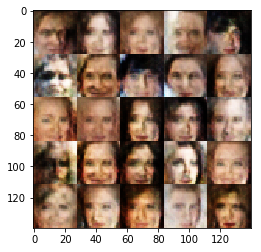

Epoch 1/1... Discriminator Loss: 1.6528... Generator Loss: 0.5948
Epoch 1/1... Discriminator Loss: 0.7842... Generator Loss: 1.1803


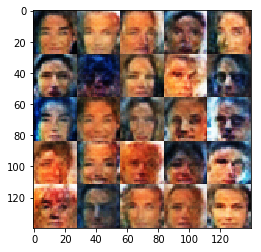

Epoch 1/1... Discriminator Loss: 1.7362... Generator Loss: 0.8503
Epoch 1/1... Discriminator Loss: 0.8177... Generator Loss: 1.2142


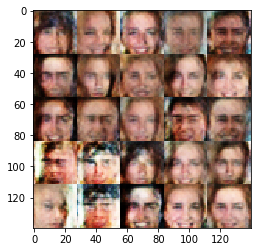

Epoch 1/1... Discriminator Loss: 1.0470... Generator Loss: 1.4344
Epoch 1/1... Discriminator Loss: 0.8382... Generator Loss: 1.0493


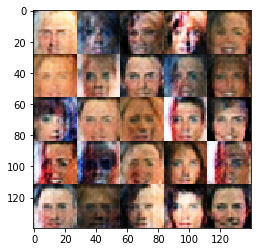

Epoch 1/1... Discriminator Loss: 0.9280... Generator Loss: 1.2481
Epoch 1/1... Discriminator Loss: 0.5664... Generator Loss: 1.9615


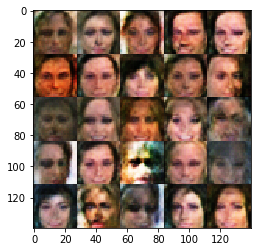

Epoch 1/1... Discriminator Loss: 1.2390... Generator Loss: 1.0260
Epoch 1/1... Discriminator Loss: 1.5975... Generator Loss: 0.7687


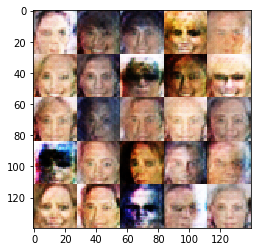

Epoch 1/1... Discriminator Loss: 1.0786... Generator Loss: 0.9639
Epoch 1/1... Discriminator Loss: 0.8202... Generator Loss: 1.1200


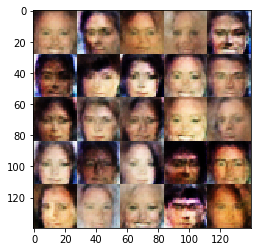

Epoch 1/1... Discriminator Loss: 0.8054... Generator Loss: 1.2721
Epoch 1/1... Discriminator Loss: 0.6297... Generator Loss: 1.4725


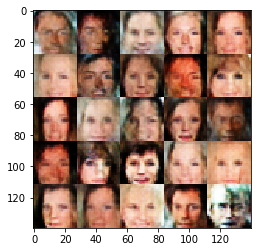

Epoch 1/1... Discriminator Loss: 0.8356... Generator Loss: 1.1738
Epoch 1/1... Discriminator Loss: 0.8062... Generator Loss: 1.3410


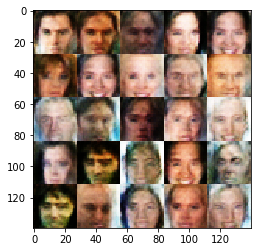

Epoch 1/1... Discriminator Loss: 1.2016... Generator Loss: 1.2834
Epoch 1/1... Discriminator Loss: 0.9558... Generator Loss: 1.5168


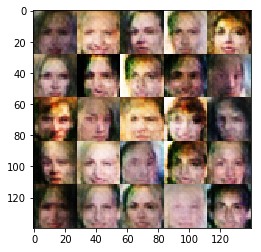

Epoch 1/1... Discriminator Loss: 0.9307... Generator Loss: 1.0767
Epoch 1/1... Discriminator Loss: 0.9571... Generator Loss: 0.9903


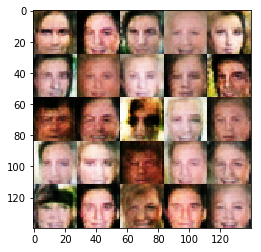

Epoch 1/1... Discriminator Loss: 1.1246... Generator Loss: 1.1936
Epoch 1/1... Discriminator Loss: 0.8668... Generator Loss: 1.1345


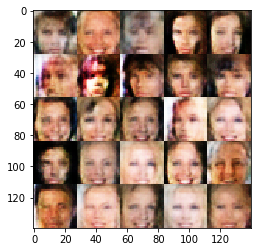

Epoch 1/1... Discriminator Loss: 1.3284... Generator Loss: 0.8431
Epoch 1/1... Discriminator Loss: 0.6694... Generator Loss: 1.4080


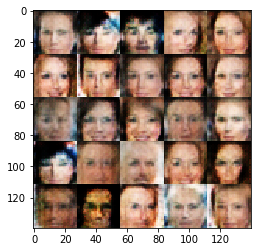

Epoch 1/1... Discriminator Loss: 0.7645... Generator Loss: 1.3671
Epoch 1/1... Discriminator Loss: 0.8816... Generator Loss: 1.2888


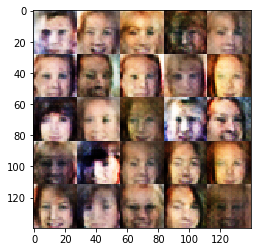

Epoch 1/1... Discriminator Loss: 0.9060... Generator Loss: 1.4270
Epoch 1/1... Discriminator Loss: 1.3382... Generator Loss: 0.7142


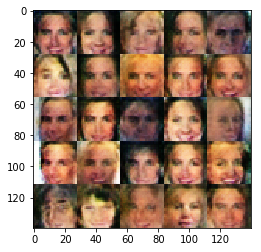

Epoch 1/1... Discriminator Loss: 0.7873... Generator Loss: 1.4765
Epoch 1/1... Discriminator Loss: 0.8336... Generator Loss: 1.3511


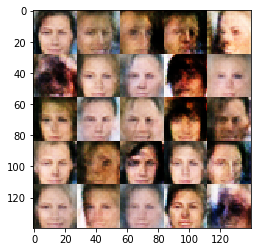

Epoch 1/1... Discriminator Loss: 1.1848... Generator Loss: 0.8269
Epoch 1/1... Discriminator Loss: 0.7212... Generator Loss: 1.4981


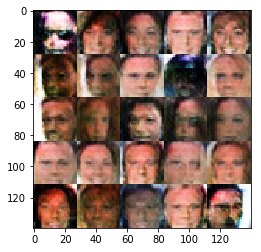

Epoch 1/1... Discriminator Loss: 0.8996... Generator Loss: 1.1380
Epoch 1/1... Discriminator Loss: 1.1775... Generator Loss: 1.2221


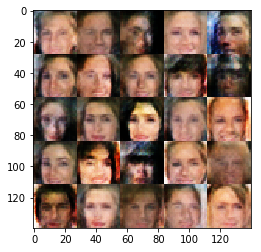

Epoch 1/1... Discriminator Loss: 0.8967... Generator Loss: 1.1702
Epoch 1/1... Discriminator Loss: 0.6820... Generator Loss: 1.8118


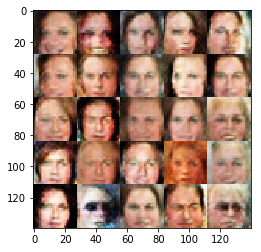

Epoch 1/1... Discriminator Loss: 0.8044... Generator Loss: 1.1881
Epoch 1/1... Discriminator Loss: 0.6330... Generator Loss: 1.4231


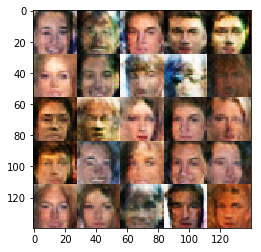

Epoch 1/1... Discriminator Loss: 1.6036... Generator Loss: 0.6799
Epoch 1/1... Discriminator Loss: 1.1603... Generator Loss: 0.8876


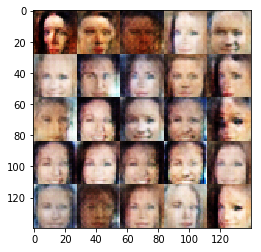

Epoch 1/1... Discriminator Loss: 0.8635... Generator Loss: 1.7487
Epoch 1/1... Discriminator Loss: 0.9805... Generator Loss: 1.3295


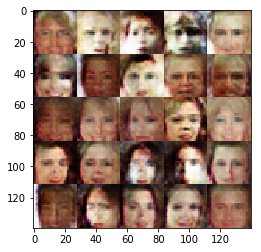

Epoch 1/1... Discriminator Loss: 0.6411... Generator Loss: 2.0307
Epoch 1/1... Discriminator Loss: 0.7189... Generator Loss: 1.2669


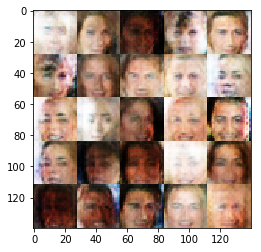

Epoch 1/1... Discriminator Loss: 1.0134... Generator Loss: 1.1783
Epoch 1/1... Discriminator Loss: 0.7045... Generator Loss: 1.4001


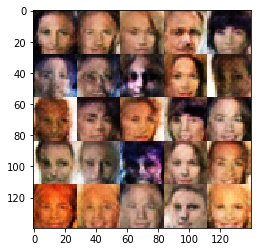

Epoch 1/1... Discriminator Loss: 1.4584... Generator Loss: 0.6815
Epoch 1/1... Discriminator Loss: 0.9211... Generator Loss: 0.9490


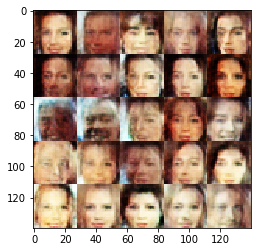

Epoch 1/1... Discriminator Loss: 1.1330... Generator Loss: 1.0855
Epoch 1/1... Discriminator Loss: 1.1483... Generator Loss: 1.6030


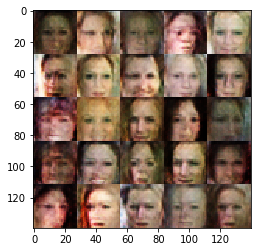

Epoch 1/1... Discriminator Loss: 1.2036... Generator Loss: 0.8498
Epoch 1/1... Discriminator Loss: 0.7002... Generator Loss: 1.3317


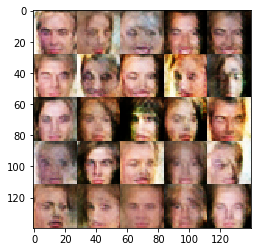

Epoch 1/1... Discriminator Loss: 1.0718... Generator Loss: 1.1678
Epoch 1/1... Discriminator Loss: 0.7413... Generator Loss: 1.2220


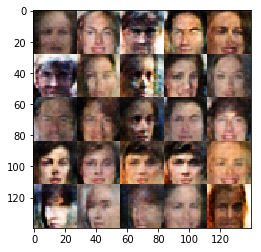

Epoch 1/1... Discriminator Loss: 0.8102... Generator Loss: 1.1812
Epoch 1/1... Discriminator Loss: 0.7117... Generator Loss: 1.3400


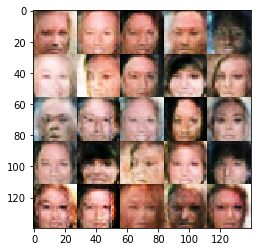

Epoch 1/1... Discriminator Loss: 1.2205... Generator Loss: 0.9629
Epoch 1/1... Discriminator Loss: 1.1381... Generator Loss: 0.9465


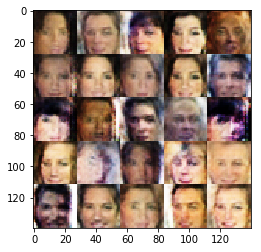

Epoch 1/1... Discriminator Loss: 0.6874... Generator Loss: 1.4016
Epoch 1/1... Discriminator Loss: 1.1904... Generator Loss: 0.7019


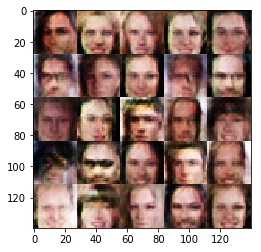

Epoch 1/1... Discriminator Loss: 0.8750... Generator Loss: 1.2275
Epoch 1/1... Discriminator Loss: 1.3817... Generator Loss: 0.6473


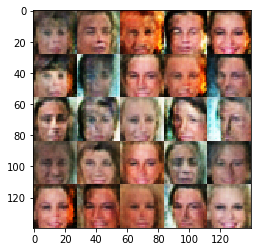

Epoch 1/1... Discriminator Loss: 0.9267... Generator Loss: 1.0200
Epoch 1/1... Discriminator Loss: 1.2288... Generator Loss: 0.7607


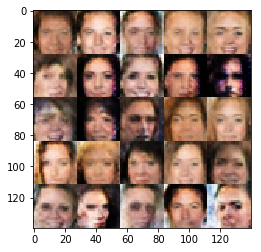

Epoch 1/1... Discriminator Loss: 1.1306... Generator Loss: 1.0026
Epoch 1/1... Discriminator Loss: 0.9214... Generator Loss: 1.0828


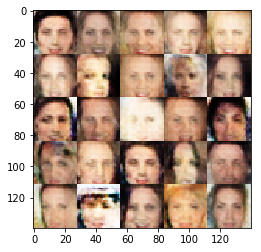

Epoch 1/1... Discriminator Loss: 0.6539... Generator Loss: 1.5912
Epoch 1/1... Discriminator Loss: 0.9280... Generator Loss: 1.3982


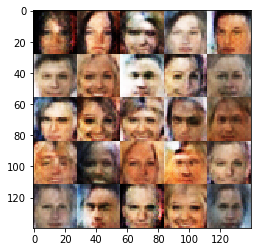

Epoch 1/1... Discriminator Loss: 0.9580... Generator Loss: 0.9878
Epoch 1/1... Discriminator Loss: 0.8204... Generator Loss: 1.1689


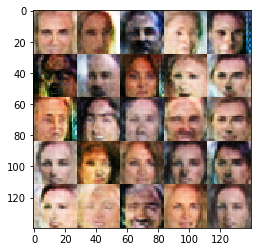

Epoch 1/1... Discriminator Loss: 0.9469... Generator Loss: 1.0025
Epoch 1/1... Discriminator Loss: 1.1242... Generator Loss: 0.8861


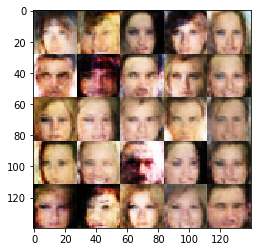

Epoch 1/1... Discriminator Loss: 1.0650... Generator Loss: 1.0255
Epoch 1/1... Discriminator Loss: 0.8149... Generator Loss: 1.1422


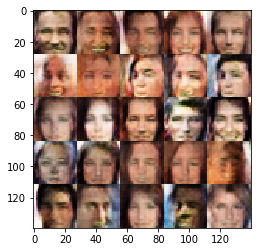

Epoch 1/1... Discriminator Loss: 1.0658... Generator Loss: 0.8461
Epoch 1/1... Discriminator Loss: 1.4768... Generator Loss: 0.6589


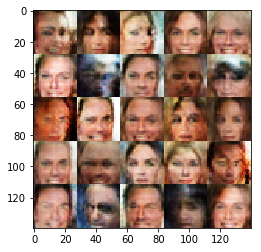

Epoch 1/1... Discriminator Loss: 1.4109... Generator Loss: 0.9930
Epoch 1/1... Discriminator Loss: 1.0771... Generator Loss: 1.0280


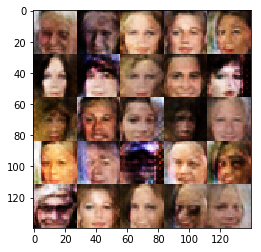

Epoch 1/1... Discriminator Loss: 1.0431... Generator Loss: 0.9430
Epoch 1/1... Discriminator Loss: 1.2420... Generator Loss: 0.7551


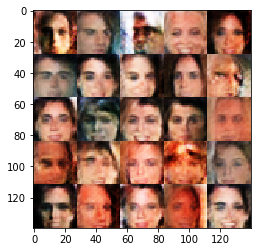

Epoch 1/1... Discriminator Loss: 1.1565... Generator Loss: 0.8611
Epoch 1/1... Discriminator Loss: 0.8764... Generator Loss: 1.2267


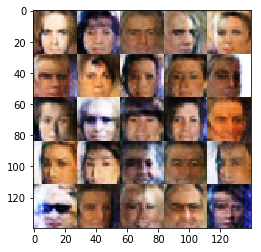

Epoch 1/1... Discriminator Loss: 1.1603... Generator Loss: 1.1636
Epoch 1/1... Discriminator Loss: 0.9458... Generator Loss: 1.0113


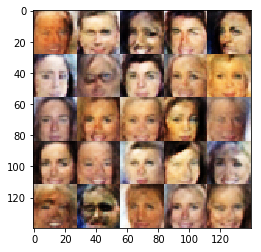

Epoch 1/1... Discriminator Loss: 1.0388... Generator Loss: 0.9533
Epoch 1/1... Discriminator Loss: 1.2171... Generator Loss: 1.0621


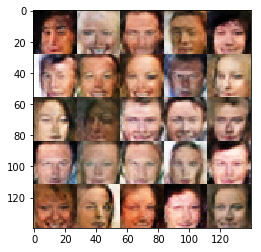

Epoch 1/1... Discriminator Loss: 1.0064... Generator Loss: 1.1872
Epoch 1/1... Discriminator Loss: 0.8472... Generator Loss: 1.0571


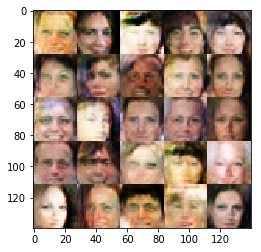

Epoch 1/1... Discriminator Loss: 1.0533... Generator Loss: 1.2210
Epoch 1/1... Discriminator Loss: 1.1810... Generator Loss: 1.0190


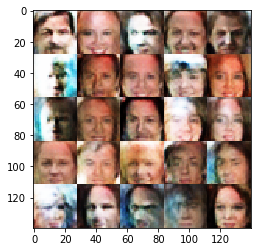

Epoch 1/1... Discriminator Loss: 0.7716... Generator Loss: 1.3291
Epoch 1/1... Discriminator Loss: 1.2185... Generator Loss: 0.9847


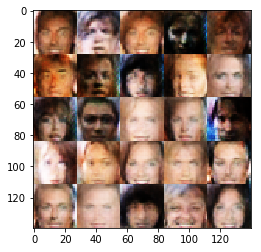

Epoch 1/1... Discriminator Loss: 0.9777... Generator Loss: 1.2124
Epoch 1/1... Discriminator Loss: 0.9510... Generator Loss: 1.2426


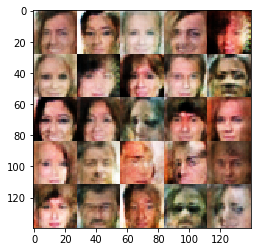

Epoch 1/1... Discriminator Loss: 1.0102... Generator Loss: 1.1170
Epoch 1/1... Discriminator Loss: 1.0285... Generator Loss: 0.9003


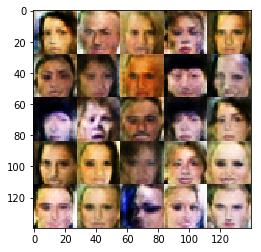

Epoch 1/1... Discriminator Loss: 0.8513... Generator Loss: 1.1134
Epoch 1/1... Discriminator Loss: 1.0901... Generator Loss: 0.7904


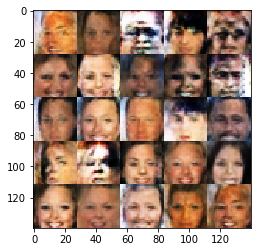

Epoch 1/1... Discriminator Loss: 0.9190... Generator Loss: 1.1261
Epoch 1/1... Discriminator Loss: 1.0565... Generator Loss: 0.9121


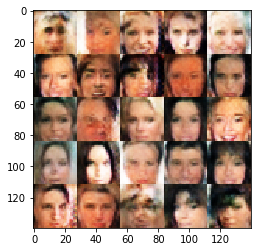

Epoch 1/1... Discriminator Loss: 0.8822... Generator Loss: 0.9642
Epoch 1/1... Discriminator Loss: 1.1746... Generator Loss: 0.9500


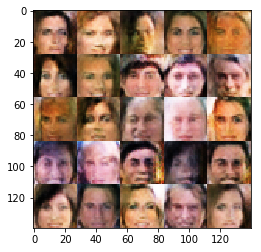

Epoch 1/1... Discriminator Loss: 1.0786... Generator Loss: 0.9331
Epoch 1/1... Discriminator Loss: 1.1739... Generator Loss: 0.7589


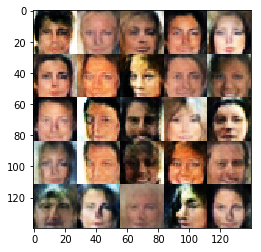

Epoch 1/1... Discriminator Loss: 1.0737... Generator Loss: 1.0387
Epoch 1/1... Discriminator Loss: 1.0667... Generator Loss: 0.9359


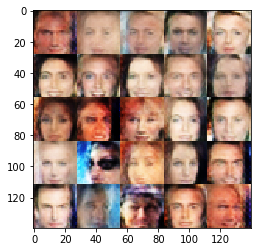

Epoch 1/1... Discriminator Loss: 1.2253... Generator Loss: 0.7184
Epoch 1/1... Discriminator Loss: 0.8659... Generator Loss: 1.3140


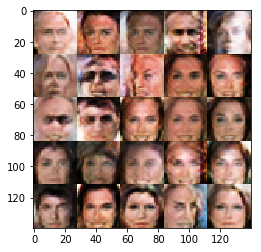

Epoch 1/1... Discriminator Loss: 1.0354... Generator Loss: 0.9997
Epoch 1/1... Discriminator Loss: 0.9883... Generator Loss: 1.0827


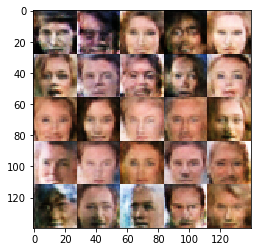

Epoch 1/1... Discriminator Loss: 1.1860... Generator Loss: 0.8832
Epoch 1/1... Discriminator Loss: 1.1475... Generator Loss: 0.8651


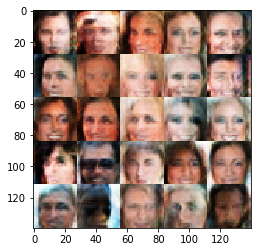

Epoch 1/1... Discriminator Loss: 0.9699... Generator Loss: 0.9298
Epoch 1/1... Discriminator Loss: 1.1090... Generator Loss: 0.8351


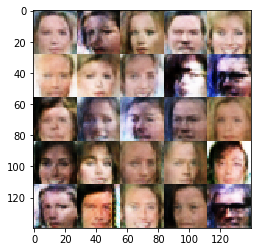

Epoch 1/1... Discriminator Loss: 1.2496... Generator Loss: 0.6541
Epoch 1/1... Discriminator Loss: 0.9496... Generator Loss: 1.0609


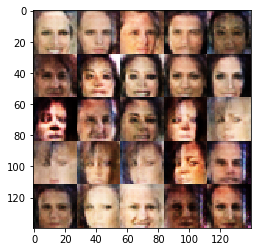

Epoch 1/1... Discriminator Loss: 0.9508... Generator Loss: 1.0844
Epoch 1/1... Discriminator Loss: 0.7833... Generator Loss: 1.3316


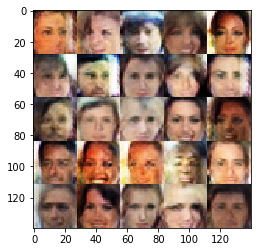

Epoch 1/1... Discriminator Loss: 0.9879... Generator Loss: 0.8578
Epoch 1/1... Discriminator Loss: 1.0618... Generator Loss: 0.8151


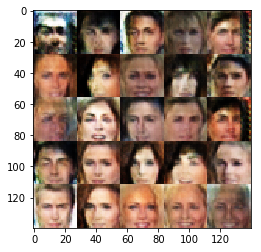

Epoch 1/1... Discriminator Loss: 0.8122... Generator Loss: 1.1629
Epoch 1/1... Discriminator Loss: 0.9945... Generator Loss: 1.2397


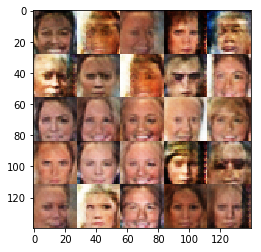

Epoch 1/1... Discriminator Loss: 0.8945... Generator Loss: 1.0241
Epoch 1/1... Discriminator Loss: 0.8271... Generator Loss: 1.1761


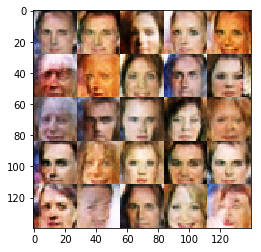

Epoch 1/1... Discriminator Loss: 0.9602... Generator Loss: 1.1111
Epoch 1/1... Discriminator Loss: 1.1884... Generator Loss: 0.7373


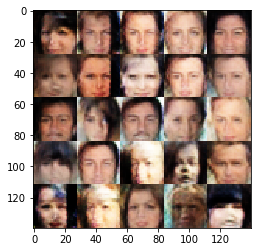

Epoch 1/1... Discriminator Loss: 1.0980... Generator Loss: 1.1693
Epoch 1/1... Discriminator Loss: 1.0500... Generator Loss: 0.7773


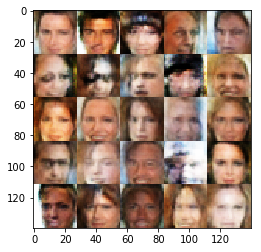

Epoch 1/1... Discriminator Loss: 1.1700... Generator Loss: 1.2437
Epoch 1/1... Discriminator Loss: 1.0523... Generator Loss: 1.1383


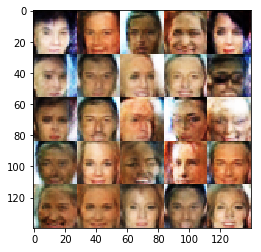

Epoch 1/1... Discriminator Loss: 1.1150... Generator Loss: 1.1153
Epoch 1/1... Discriminator Loss: 1.4042... Generator Loss: 0.8807


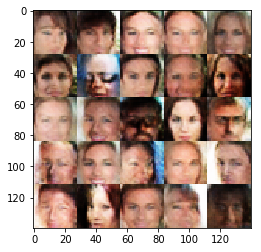

Epoch 1/1... Discriminator Loss: 0.9109... Generator Loss: 1.0941
Epoch 1/1... Discriminator Loss: 1.4562... Generator Loss: 0.7363


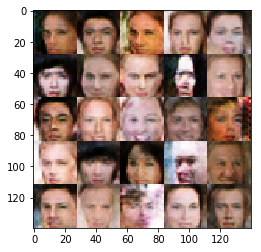

Epoch 1/1... Discriminator Loss: 1.4263... Generator Loss: 0.6859
Epoch 1/1... Discriminator Loss: 0.9969... Generator Loss: 0.9609


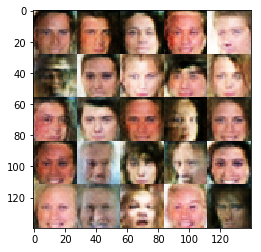

Epoch 1/1... Discriminator Loss: 1.0749... Generator Loss: 1.0712
Epoch 1/1... Discriminator Loss: 1.2471... Generator Loss: 0.7837


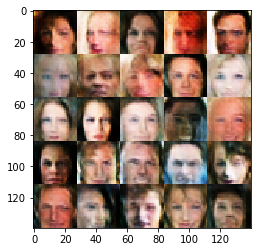

Epoch 1/1... Discriminator Loss: 1.0628... Generator Loss: 1.0810
Epoch 1/1... Discriminator Loss: 0.8027... Generator Loss: 1.4869


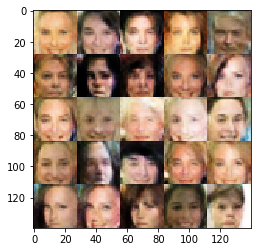

Epoch 1/1... Discriminator Loss: 1.0047... Generator Loss: 0.8658
Epoch 1/1... Discriminator Loss: 1.3538... Generator Loss: 0.7817


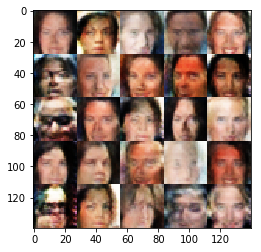

Epoch 1/1... Discriminator Loss: 1.6659... Generator Loss: 0.9142
Epoch 1/1... Discriminator Loss: 1.0515... Generator Loss: 0.9227


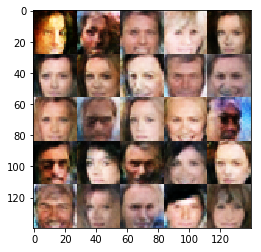

Epoch 1/1... Discriminator Loss: 1.1920... Generator Loss: 0.7779
Epoch 1/1... Discriminator Loss: 1.0812... Generator Loss: 1.1001


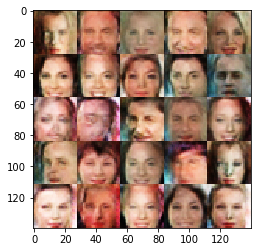

Epoch 1/1... Discriminator Loss: 0.9903... Generator Loss: 0.9763
Epoch 1/1... Discriminator Loss: 0.8912... Generator Loss: 1.1706


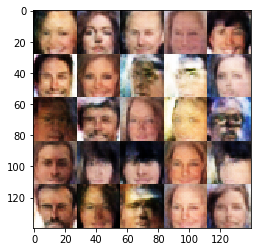

Epoch 1/1... Discriminator Loss: 1.0990... Generator Loss: 1.0163
Epoch 1/1... Discriminator Loss: 1.2381... Generator Loss: 0.9866


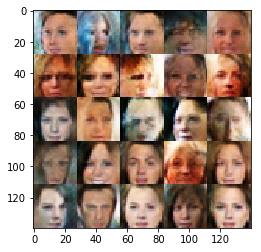

Epoch 1/1... Discriminator Loss: 0.9188... Generator Loss: 1.2143
Epoch 1/1... Discriminator Loss: 1.3405... Generator Loss: 0.7478


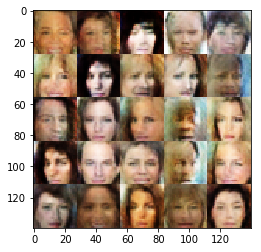

Epoch 1/1... Discriminator Loss: 1.0979... Generator Loss: 1.0472
Epoch 1/1... Discriminator Loss: 1.0793... Generator Loss: 1.0085


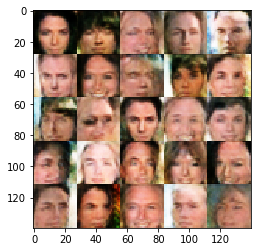

Epoch 1/1... Discriminator Loss: 1.2858... Generator Loss: 0.8438
Epoch 1/1... Discriminator Loss: 1.6289... Generator Loss: 0.5635


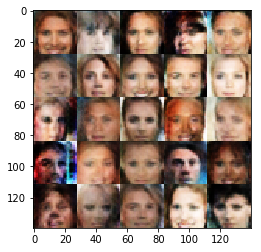

Epoch 1/1... Discriminator Loss: 1.0446... Generator Loss: 0.9782
Epoch 1/1... Discriminator Loss: 1.1224... Generator Loss: 0.9537


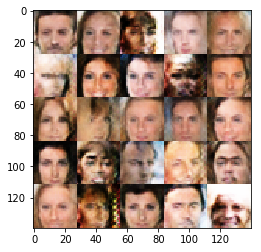

Epoch 1/1... Discriminator Loss: 1.1700... Generator Loss: 0.9907
Epoch 1/1... Discriminator Loss: 1.0018... Generator Loss: 1.1888


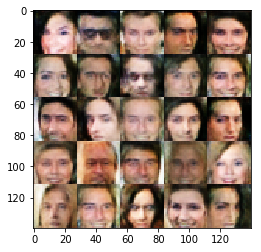

Epoch 1/1... Discriminator Loss: 1.2951... Generator Loss: 0.7504
Epoch 1/1... Discriminator Loss: 1.0802... Generator Loss: 1.2208


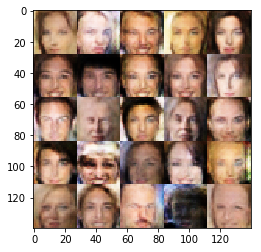

Epoch 1/1... Discriminator Loss: 1.0689... Generator Loss: 0.9876
Epoch 1/1... Discriminator Loss: 0.8688... Generator Loss: 1.2537


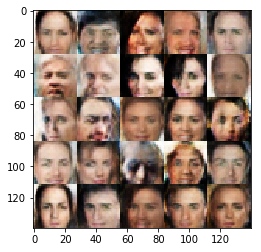

Epoch 1/1... Discriminator Loss: 1.1077... Generator Loss: 0.7691
Epoch 1/1... Discriminator Loss: 1.2218... Generator Loss: 0.8925


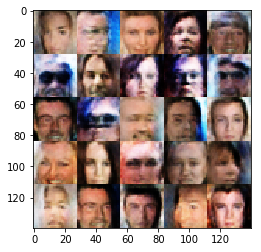

Epoch 1/1... Discriminator Loss: 1.2183... Generator Loss: 0.8566
Epoch 1/1... Discriminator Loss: 1.2458... Generator Loss: 0.7724


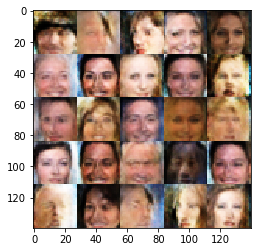

Epoch 1/1... Discriminator Loss: 1.0637... Generator Loss: 1.0375
Epoch 1/1... Discriminator Loss: 1.1034... Generator Loss: 0.9251


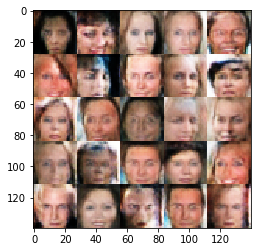

Epoch 1/1... Discriminator Loss: 1.3045... Generator Loss: 0.9004
Epoch 1/1... Discriminator Loss: 0.7957... Generator Loss: 1.2900


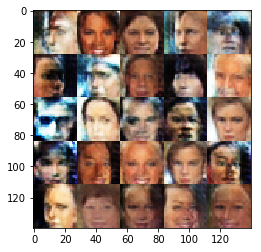

Epoch 1/1... Discriminator Loss: 1.1984... Generator Loss: 0.7222
Epoch 1/1... Discriminator Loss: 1.2497... Generator Loss: 0.8999


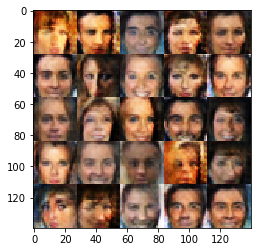

Epoch 1/1... Discriminator Loss: 1.2242... Generator Loss: 0.7523
Epoch 1/1... Discriminator Loss: 1.2314... Generator Loss: 0.9667


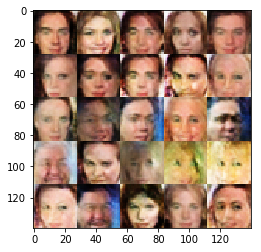

Epoch 1/1... Discriminator Loss: 1.0171... Generator Loss: 1.0766
Epoch 1/1... Discriminator Loss: 0.9377... Generator Loss: 1.0688


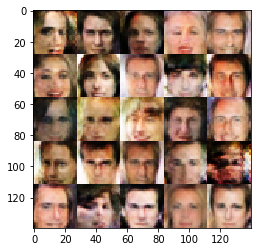

Epoch 1/1... Discriminator Loss: 1.1938... Generator Loss: 0.9657
Epoch 1/1... Discriminator Loss: 0.9477... Generator Loss: 0.9963


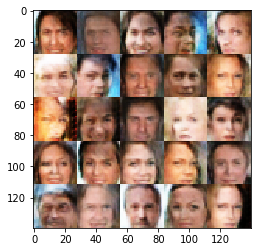

Epoch 1/1... Discriminator Loss: 0.8870... Generator Loss: 1.2840
Epoch 1/1... Discriminator Loss: 1.1513... Generator Loss: 0.8952


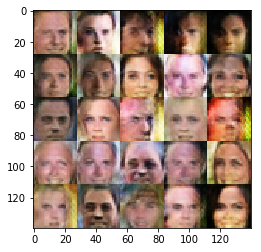

Epoch 1/1... Discriminator Loss: 1.3826... Generator Loss: 0.7335
Epoch 1/1... Discriminator Loss: 1.1154... Generator Loss: 1.0957


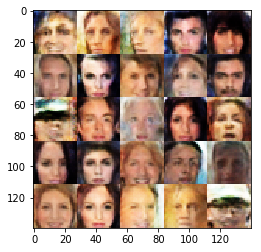

Epoch 1/1... Discriminator Loss: 0.9756... Generator Loss: 1.5315
Epoch 1/1... Discriminator Loss: 0.8877... Generator Loss: 1.0743


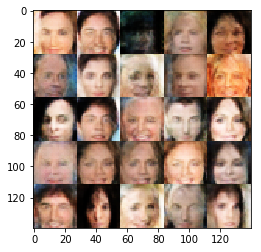

Epoch 1/1... Discriminator Loss: 0.9528... Generator Loss: 1.0677
Epoch 1/1... Discriminator Loss: 1.5043... Generator Loss: 0.8411


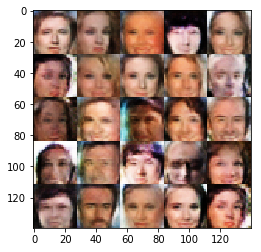

Epoch 1/1... Discriminator Loss: 1.0351... Generator Loss: 0.9170
Epoch 1/1... Discriminator Loss: 1.0702... Generator Loss: 0.9160


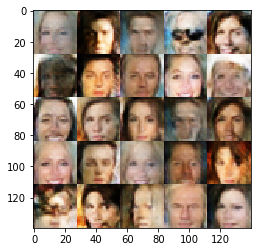

Epoch 1/1... Discriminator Loss: 1.3110... Generator Loss: 0.7080
Epoch 1/1... Discriminator Loss: 0.9723... Generator Loss: 1.0836


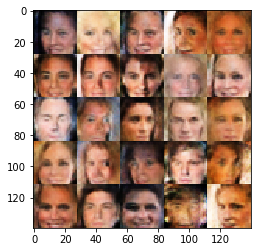

Epoch 1/1... Discriminator Loss: 1.4096... Generator Loss: 0.6621
Epoch 1/1... Discriminator Loss: 1.3838... Generator Loss: 0.7835


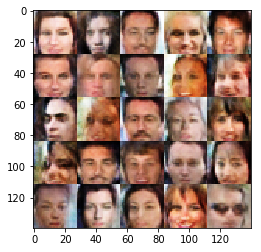

Epoch 1/1... Discriminator Loss: 1.1691... Generator Loss: 0.9284
Epoch 1/1... Discriminator Loss: 1.3344... Generator Loss: 0.6495


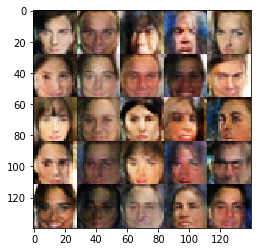

Epoch 1/1... Discriminator Loss: 0.9607... Generator Loss: 1.0651
Epoch 1/1... Discriminator Loss: 0.9275... Generator Loss: 1.1609


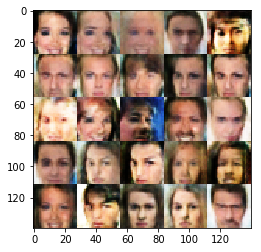

Epoch 1/1... Discriminator Loss: 1.1967... Generator Loss: 0.7994
Epoch 1/1... Discriminator Loss: 1.2078... Generator Loss: 0.8738


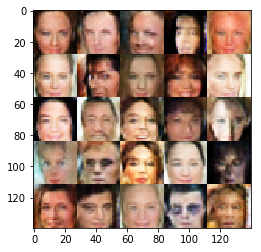

Epoch 1/1... Discriminator Loss: 1.1944... Generator Loss: 0.7388
Epoch 1/1... Discriminator Loss: 1.5245... Generator Loss: 0.6996


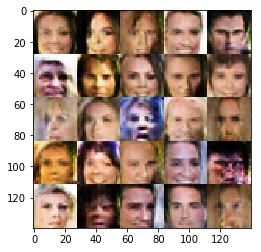

Epoch 1/1... Discriminator Loss: 0.9313... Generator Loss: 1.1371
Epoch 1/1... Discriminator Loss: 1.1087... Generator Loss: 0.8045


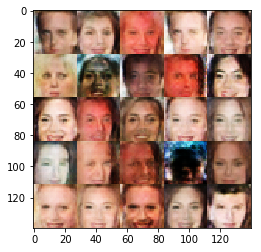

Epoch 1/1... Discriminator Loss: 1.3193... Generator Loss: 0.8151
Epoch 1/1... Discriminator Loss: 0.9523... Generator Loss: 0.9692


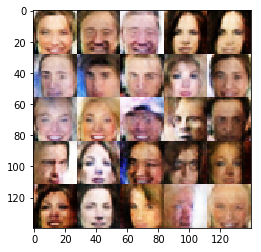

Epoch 1/1... Discriminator Loss: 1.2977... Generator Loss: 0.7533
Epoch 1/1... Discriminator Loss: 1.3077... Generator Loss: 0.9505


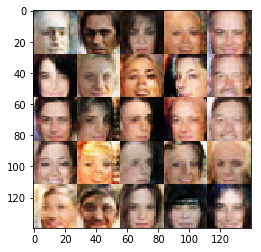

Epoch 1/1... Discriminator Loss: 0.9907... Generator Loss: 0.9606
Epoch 1/1... Discriminator Loss: 0.9004... Generator Loss: 1.5349


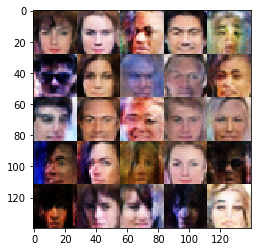

Epoch 1/1... Discriminator Loss: 1.0500... Generator Loss: 0.9055
Epoch 1/1... Discriminator Loss: 1.2033... Generator Loss: 0.6964


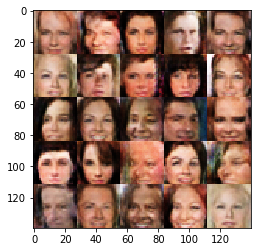

Epoch 1/1... Discriminator Loss: 1.2838... Generator Loss: 0.5721
Epoch 1/1... Discriminator Loss: 0.8769... Generator Loss: 1.3942


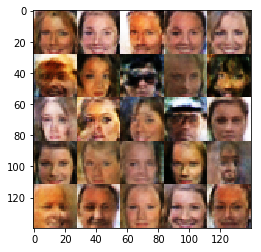

Epoch 1/1... Discriminator Loss: 1.0487... Generator Loss: 0.9962
Epoch 1/1... Discriminator Loss: 1.1562... Generator Loss: 0.8743


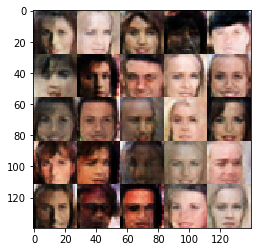

Epoch 1/1... Discriminator Loss: 0.8964... Generator Loss: 1.0568
Epoch 1/1... Discriminator Loss: 1.0421... Generator Loss: 1.0625


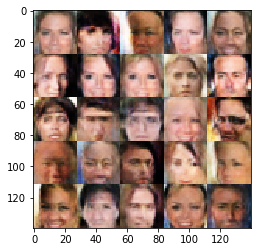

Epoch 1/1... Discriminator Loss: 1.2220... Generator Loss: 0.7193


In [14]:
batch_size = 5 #can't do larger batches, due to my GPU's memory limits :'-(
z_dim = 15
learning_rate = 0.0005
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 1

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### Submitting This Project
When submitting this project, make sure to run all the cells before saving the notebook. Save the notebook file as "dlnd_face_generation.ipynb" and save it as a HTML file under "File" -> "Download as". Include the "helper.py" and "problem_unittests.py" files in your submission.